# Voyager I

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import math as m
from scipy.optimize import fsolve, brentq, newton, least_squares, fmin
from matplotlib.lines import Line2D
from matplotlib import colors
from scipy.interpolate import griddata
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import ScalarFormatter
import time
import warnings
from tqdm import tqdm
import os
import pickle

from astropy import units as u
from astropy.time import Time
from astropy.coordinates import solar_system_ephemeris
solar_system_ephemeris.set("jpl")

from poliastro.bodies import *
from poliastro.ephem import Ephem
from poliastro.frames import Planes
from poliastro.maneuver import Maneuver
from poliastro.twobody import Orbit
from poliastro.util import norm, time_range
from poliastro.plotting.static import StaticOrbitPlotter

from itertools import permutations, combinations
from random import shuffle
import random
import statistics
import seaborn as sns
from IPython.display import HTML
import matplotlib.animation as animation

from poliastro.core.iod import vallado
from poliastro.core.elements import rv2coe
import datetime

def show(variable, units):
    def get_var_name(var):
        for name, value in globals().items():
            if value is var:
                return name
    print(get_var_name(variable), "=", variable, units)

plt.rc('text', usetex=True)
plt.rc('font', family='serif')

In [3]:
global_flag = False

In [4]:
mu_earth = Earth.k.to(u.km**3/u.s**2).value
mu_jupiter = Jupiter.k.to(u.km**3/u.s**2).value
mu_saturn = Saturn.k.to(u.km**3/u.s**2).value
mu_sun = Sun.k.to(u.km**3/u.s**2).value
mu_sun

132712442099.00002

In [5]:
mu = mu_sun # Sun's gravitational parameter (km³/s²)
mu

132712442099.00002

In [6]:
# Define parula colormap (MATLAB-style) with an option to reverse
def parula_map(reverse=False):
    # RGB values
    cm_data = [
        [0.2081, 0.1663, 0.5292], [0.2116, 0.1898, 0.5777], [0.2123, 0.2138, 0.6270],
        [0.2081, 0.2386, 0.6771], [0.1959, 0.2645, 0.7279], [0.1707, 0.2919, 0.7792],
        [0.1253, 0.3242, 0.8303], [0.0591, 0.3598, 0.8683], [0.0117, 0.3875, 0.8820],
        [0.0060, 0.4086, 0.8828], [0.0165, 0.4266, 0.8786], [0.0329, 0.4430, 0.8720],
        [0.0498, 0.4586, 0.8641], [0.0629, 0.4737, 0.8554], [0.0723, 0.4887, 0.8467],
        [0.0779, 0.5040, 0.8384], [0.0793, 0.5200, 0.8312], [0.0749, 0.5375, 0.8263],
        [0.0641, 0.5570, 0.8240], [0.0488, 0.5772, 0.8228], [0.0343, 0.5966, 0.8199],
        [0.0265, 0.6137, 0.8135], [0.0239, 0.6287, 0.8038], [0.0231, 0.6418, 0.7913],
        [0.0228, 0.6535, 0.7768], [0.0267, 0.6642, 0.7607], [0.0384, 0.6743, 0.7436],
        [0.0590, 0.6838, 0.7254], [0.0843, 0.6928, 0.7062], [0.1133, 0.7015, 0.6859],
        [0.1453, 0.7098, 0.6646], [0.1801, 0.7177, 0.6424], [0.2178, 0.7250, 0.6193],
        [0.2586, 0.7317, 0.5954], [0.3022, 0.7376, 0.5712], [0.3482, 0.7424, 0.5473],
        [0.3953, 0.7459, 0.5244], [0.4420, 0.7481, 0.5033], [0.4871, 0.7491, 0.4840],
        [0.5300, 0.7491, 0.4661], [0.5709, 0.7485, 0.4494], [0.6099, 0.7473, 0.4337],
        [0.6473, 0.7456, 0.4188], [0.6834, 0.7435, 0.4044], [0.7184, 0.7411, 0.3905],
        [0.7525, 0.7384, 0.3768], [0.7858, 0.7356, 0.3633], [0.8185, 0.7327, 0.3498],
        [0.8507, 0.7299, 0.3360], [0.8824, 0.7274, 0.3217], [0.9139, 0.7258, 0.3063],
        [0.9450, 0.7261, 0.2886], [0.9739, 0.7314, 0.2666], [0.9938, 0.7455, 0.2403],
        [0.9990, 0.7653, 0.2164], [0.9955, 0.7861, 0.1967], [0.9880, 0.8066, 0.1794],
        [0.9789, 0.8271, 0.1633], [0.9697, 0.8481, 0.1475], [0.9626, 0.8705, 0.1309],
        [0.9589, 0.8949, 0.1132], [0.9598, 0.9218, 0.0948], [0.9661, 0.9514, 0.0755],
        [0.9763, 0.9831, 0.0538]
    ]
    
    if reverse:
        cm_data = cm_data[::-1]  # Reverse the list if specified
        
    return colors.ListedColormap(cm_data)

## 1) Choose the epochs $T_1$ to $T_N$, corresponding to all the planets $P_1$ to $P_N$ in the mission. This is decided later in the optimisation algorithm.

In [8]:
#Voyager I real mission timing
scale = "tt"

date_departure = date_earth_jupiter = "1977-09-08 09:08"

date_flyby_jupiter = "1979-03-05 12:05"
#date_jupiter_saturn = "1979-04-24 07:33:03"

date_arrival = date_flyby_saturn = "1980-11-12 23:46"

### 1.1) Convert epochs to MJD

In [10]:
from astropy.time import Time
# e.g T_et = "1979-03-05 12:05:26"
def convert_ET(T_et):
    # Defines time scale for astropy.time of ET, which approx equal to TT 
    T_tt = Time(T_et, scale='tt')
    # Calculate TDB (only 1-2 milliseconds different from ET/TT)
    T_tdb = T_tt.tdb
    # Calculates the TAI (T_tai = T_tt - 32.184s)
    T_tai = T_tt.tai
    # Calculates the JD from epoch 1st January 4713 BC at 12:00 TT
    T_jd = T_tt.jd 
    # Calculates MJD
    T_mjd = T_jd - 2400000.5 
    # Calculate UTC using NASA's Sprice Time Subsystem
    T_utc = T_tt.utc
    return {"TDB": T_tdb, "TAI": T_tai, "JD": T_jd, "MJD": T_mjd, "UTC": T_utc}

scale = "mjd"

date_departure_mjd = convert_ET(date_departure)['MJD']

date_flyby_jupiter_mjd = convert_ET(date_flyby_jupiter)['MJD']
#date_jupiter_saturn_mjd = convert_ET(date_jupiter_saturn)['MJD']

date_flyby_saturn_mjd = convert_ET(date_flyby_saturn)['MJD']

show(date_departure_mjd,"MJD")
show(date_flyby_jupiter_mjd,"MJD")
show(date_flyby_saturn_mjd,"MJD")

date_departure_mjd = 43394.38055555569 MJD
date_flyby_jupiter_mjd = 43937.503472222015 MJD
date_flyby_saturn_mjd = 44555.99027777789 MJD


### 1.2) Find the $\Delta t$ for each mission trajectory

In [12]:
def find_tof(start_date_days, end_date_days):
    delta_t = (end_date_days - start_date_days) * (60*60*24)
    return delta_t

delta_t_earth_jupiter = find_tof(date_departure_mjd, date_flyby_jupiter_mjd)
delta_t_jupiter_saturn = find_tof(date_flyby_jupiter_mjd, date_flyby_saturn_mjd)
print("Earth-Jupiter:",delta_t_earth_jupiter,"s")
print("Jupiter-Saturn:",delta_t_jupiter_saturn,"s")

Earth-Jupiter: 46925819.999970496 s
Jupiter-Saturn: 53437260.000027716 s


## 2) Using the known epochs $T_1$ to $T_N$, calculate their respective planetary state vectors $\{\vec{\mathbf{r}},\vec{\mathbf{V}}^{\,(\text{P})}\}$ using Algorithm 3.3.

In [14]:
def get_planet_state_vector(planet, date_time, scale):
    # Convert the date_time in MJD to modern TDB time scale 
    date = Time(date_time, format='mjd', scale=scale).tdb
    # Generate the planet's ephemeris at the given time
    planet_ephem = Ephem.from_body(planet, date, plane=Planes.EARTH_ECLIPTIC)
    # Extract the position and velocity vectors
    r, v = planet_ephem.rv(date)
    r = r.to(u.km)
    v = v.to(u.km/u.s) 
    return r, v

scale = 'tt'
r_earth, v_earth = get_planet_state_vector(Earth, date_departure_mjd, scale)
r_jupiter, v_jupiter = get_planet_state_vector(Jupiter, date_flyby_jupiter_mjd, scale)
r_saturn, v_saturn = get_planet_state_vector(Saturn, date_flyby_saturn_mjd, scale)

In [15]:
print("Earth:")
display(r_earth, v_earth)
print("Jupiter:")
display(r_jupiter, v_jupiter)
print("Saturn:")
display(r_saturn, v_saturn)

Earth:


<Quantity [ 1.46527291e+08, -3.73266666e+07, -1.03602400e+04] km>

<Quantity [6.78843938e+00, 2.87867619e+01, 1.02335131e-03] km / s>

Jupiter:


<Quantity [-4.81215109e+08,  6.27073938e+08,  8.19439645e+06] km>

<Quantity [-10.51367988,  -7.3532518 ,   0.26572085] km / s>

Saturn:


<Quantity [-1.42004992e+09, -5.43085654e+07,  5.73830616e+07] km>

<Quantity [-0.14811167, -9.66974421,  0.17492744] km / s>

In [16]:
r_earth, v_earth = r_earth.value, v_earth.value
r_jupiter, v_jupiter = r_jupiter.value, v_jupiter.value
r_saturn, v_saturn = r_saturn.value, v_saturn.value

## 3) Now, to define the transfer trajectory we separate them into legs: $P_1\text{-}P_2$, $P_2\text{-}P_3$, ..., $P_{N-1}\text{-}P_N$. For each leg, we can use the solution to Lambert's Problem (Algorithm 3.4) to get its transfer velocity vectors. This fully defines each leg, where for instance $P_1\text{-}P_2$ leg, we have the following parameters $\big\{\vec{\mathbf{r}}_{1}, \vec{\mathbf{r}}_{2}, \vec{\mathbf{V}}^{\,(\text{P})}_1,\vec{\mathbf{V}}^{\,(\text{P})}_2, (\vec{\mathbf{v}})_{D}, (\vec{\mathbf{v}}_{T_2})_{A}, \Delta t\big\}$.

In [18]:
# from poliastro.core.iod import vallado

# # Lambert Solver
# def lambert(r1, r2, delta_t):
#     v_d, v_a = vallado(mu_sun, r1, r2, delta_t, M=0, prograde=True, lowpath=True, numiter=1e6, rtol=1e-8)
#     return v_d, v_a

import numpy as np
from scipy.optimize import brentq, newton, least_squares

# Known parameters [r1, r2, delta_t]
mu = 1.327e11  # Sun's gravitational parameter (km^3/s^2)


# Stumpff functions
def C(z):
    if z > 0:
        return (1 - np.cos(np.sqrt(z))) / z
    elif z < 0:
        return (np.cosh(np.sqrt(-z)) - 1) / (-z)
    else:
        return 0.5


def S(z):
    if z > 0:
        return (np.sqrt(z) - np.sin(np.sqrt(z))) / (z**1.5)
    elif z < 0:
        return (np.sinh(np.sqrt(-z)) - np.sqrt(-z)) / ((-z) ** 1.5)
    else:
        return 1 / 6


# Compute y parameter
def compute_y(z, r1, r2, A):
    C_z = max(C(z), 1e-8)  # Ensure no division by zero
    return max(r1 + r2 + A * (z * S(z) - 1) / np.sqrt(C_z), 1e-8)


# Time-of-flight equation
def F_lambert(z, delta_t, r1, r2, A):
    y_val = compute_y(z, r1, r2, A)
    return ((y_val / C(z)) ** 1.5) * S(z) + A * np.sqrt(y_val) - np.sqrt(mu) * delta_t


# Lambert solver
def lambert(r1, r2, deltat):
    # Step 1: Find the delta_theta between P1 and P2
    r1_mag, r2_mag = np.linalg.norm(r1), np.linalg.norm(r2)
    delta_theta = np.arccos(np.dot(r1, r2) / (r1_mag * r2_mag))

    if np.cross(r1, r2)[2] < 0:
        delta_theta = 2 * np.pi - delta_theta

    # Step 2: Solve for the intermediate auxiliary variable z
    A = np.sin(delta_theta) * np.sqrt(r1_mag * r2_mag / (1 - np.cos(delta_theta)))

    def func(z_val):
        return F_lambert(z_val, deltat, r1_mag, r2_mag, A)

    def solver(func, z_min=-1e3, z_max=1e3, z_guess=0.01):
        try:
            z = brentq(lambda z: func(z), z_min, z_max)
        except ValueError:
            try:
                z = newton(func, z_guess)
            except RuntimeError:
                z = least_squares(func, z_guess).x[0]
        return z

    z = solver(func)
    y_val = compute_y(z, r1_mag, r2_mag, A)

    # Step 3: Compute Lagrange coefficients f, g, gdot
    f = 1 - y_val / r1_mag
    g = A * np.sqrt(y_val / mu)
    gdot = 1 - y_val / r2_mag

    v1 = (r2 - f * r1) / g
    v2 = (gdot * r2 - r1) / g
    return v1, v2

v1_d, v2_a = lambert(r_earth, r_jupiter, delta_t_earth_jupiter)
v2_d, v3_a = lambert(r_jupiter, r_saturn, delta_t_jupiter_saturn)
print(v1_d, v2_a)
print(v2_d, v3_a)

[10.72074241 38.28749663  0.66273895] [-1.22415214e+01  3.46208225e+00  6.42429222e-03]
[-20.97912678 -10.58575624   1.01828126] [-14.94072746 -13.42269638   0.82774958]


In [19]:
print(np.linalg.norm(v1_d), np.linalg.norm(v2_a))
print(np.linalg.norm(v2_d), np.linalg.norm(v3_a))

39.765637662752795 12.721670500594671
23.520605691058012 20.101723417599942


## 4) We can now work out $\Delta V_{injection}$, the initial injection burn from $P_1$ into transfer orbit,

In [21]:
deltaV_injection = v1_d - v_earth
deltaV_injection = np.linalg.norm(deltaV_injection)
deltaV_injection

10.303632164583048

In [22]:
# Isp = 287.3 #s
# g0 = 9.80665 #m/s^2

# Vex = Isp*g0 / 1000 # km/s
# Vex, 'km/s'

In [23]:
# M_0_propulsion_module = 1123 #kg
# M_f_capacity_propulsion_module = 1039 #kg

# M_after_injection = M_0_propulsion_module*( 1 - np.exp(-deltaV_injection/Vex) )
# M_after_injection

In [24]:
# deltaV = deltaV_injection
# M0 = M_0_propulsion_module
# Mf = M_f_capacity_propulsion_module

# def rocket_eq(Vex):
#     return Vex*np.log(M0/(M0 - Mf)) - deltaV

# Vex = fsolve(rocket_eq, 0.01)[0]
# Vex, 'km/s'

## Flyby

### 5) Find $\Delta V_{p\,{(flyby)}}$, we must first find the hyperbolic excess velocities $\{\vec{\mathbf{v}}_{\infty_{in}},\vec{\mathbf{v}}_{\infty_{out}} \}$ at each flyby planet

### 6) Find the planet's inbound $a_{in}$ and outbound $a_{out}$ semi-major axis

### 7) Find its deflection (turning) angle $\delta$ from entering SOI to exiting SOI

#### Here, we can utilise the equation relating deflection (turning) angle $\delta$ to the outbound eccentricity $e_{out}$ of hyperbolic trajectory,

### 8) Hence, the radius of the closest approach to the planet $r_{p\,{(flyby)}}$ can be calculated

### 9) We now have all the required parameter to equate $\Delta V_{p\,{(flyby)}}$,

In [32]:
R_jupiter = 69911 #km
R_saturn = 58232 #km

R_jupiter_SOI = 48.2e6 #km
R_saturn_SOI = 54.5e6 #km

In [33]:
# Add must be more than R_planet but less that r_SOI <-- NEED TO ADD!!!!!

def find_deltaV_flyby(v_in, v_out, v_planet, mu_planet, R_planet, R_SOI):
    vinf_in = v_in - v_planet
    vinf_out = v_out - v_planet

    a_in = - mu_planet/np.linalg.norm(vinf_in)**2
    a_out = - mu_planet/np.linalg.norm(vinf_out)**2

    deflection = np.arccos( np.dot(vinf_in,vinf_out)/( np.linalg.norm(vinf_in) * np.linalg.norm(vinf_out) ) )

    e_out = 1/np.sin(deflection/2)
    # def f(e_out):
    #     return (a_out/a_in * (e_out - 1))*np.sin( deflection - np.arcsin(1/e_out) ) - 1   
    # e_out = fsolve(f, 1.1)[0]

    rp = a_out*(1-e_out)

    if rp < R_planet and rp > R_SOI:  
        deltaV_flyby = 1e99
    else:
        vp_esc = np.sqrt(2*mu_planet/rp)
        
        vp_flyby_in = np.sqrt( np.linalg.norm(vinf_in)**2 + (2 * mu_planet)/rp )

        if vp_flyby_in > vp_esc:
            deltaV_flyby = abs(np.sqrt( np.linalg.norm(vinf_out)**2 + (2 * mu_planet)/rp ) - np.sqrt( np.linalg.norm(vinf_in)**2 + (2 * mu_planet)/rp ) )
        else:
            deltaV_flyby = 1e99

    return deltaV_flyby, rp

deltaV_jupiter, rp_jupiter = find_deltaV_flyby(v2_a,v2_d,v_jupiter,mu_jupiter,R_jupiter, R_jupiter_SOI)
deltaV_jupiter

0.008783673764401811

## 10) Finally, to summate all the individual $\Delta V$ components of the initial injection and subsequent flybys we can equate,

In [35]:
deltaV_total = deltaV_injection + deltaV_jupiter
deltaV_total

10.31241583834745

In [36]:
(date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd)

(43394.38055555569, 43937.503472222015, 44555.99027777789)

## 11) From the calculated mission $\Delta V$, we can find the fuel mass $M_f$ used.

### NASA Data

<div>
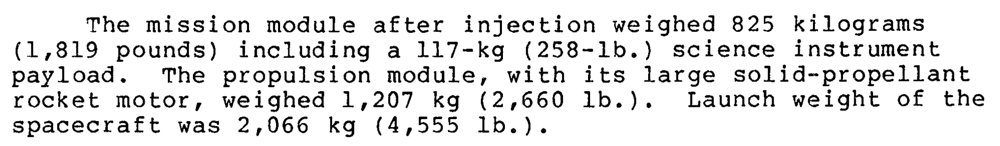
</div>

<div>
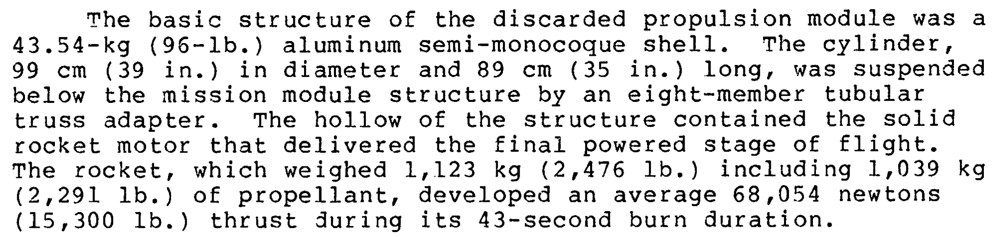
</div>

In [39]:
M0_Voyager = 2066 #kg 

M0_propulsion_module = 1207 #kg
Mf_propulsion_module = 1039 #kg

M0_mission_module = 825 #kg
Mf_mission_module = 100 #kg

Mf_total_NASA = Mf_propulsion_module + Mf_mission_module

In [40]:
F = 68054 #N
t = 43 #s
g0 = 9.80665 # m/s2

# The Isp of the actual Voyager I mission - propulsion module
Isp_NASA = (F*t)/(Mf_propulsion_module*g0)
Isp_NASA, 's'

(287.2009612891239, 's')

**Specific impulse ($I_{sp}$)** is a measure of a rocket engine's efficiency, defined as the impulse (thrust per unit weight flow of propellant) delivered per unit of propellant consumed.

### My Real Simulation Data

In [43]:
def find_Isp(Mf, M0, deltaV):
    Isp = (deltaV*1e3)/( np.log(M0/(M0 - Mf)) * g0)
    return Isp

Isp_my_sim = find_Isp(Mf_total_NASA, M0_Voyager, deltaV_total)
Isp_my_sim, 's'

(1312.1445693172518, 's')

The difference in $I_{sp}$ of NASA data and my_sim data is due to the inherit assumption in my model (Method of Patched Conics and Lambert Transfers) -- also the unpowered gravitational assist assumption.

Also, due to the fact NASA used a 2 stage system with the propulsion system ejected after injection into Earth-Jupiter transfer orbit. This left a 825kg mission module with around 100kg of fuel on it.

In [45]:
Vex = Isp_my_sim*g0 / 1000 # km/s
Vex, 'km/s'

(12.867742540695026, 'km/s')

In [46]:
M0_Voyager = M0 = 2066 #kg 

In [47]:
def compute_fuel_mass(M0, Vex, deltaV):
    Mf = M0*( 1 - np.exp(-deltaV/Vex) )
    return Mf 
    
fuel_mass_total = compute_fuel_mass(M0, Vex, deltaV_total)

print(f"The mission deltaV of {deltaV_total:.4f}km/s caused {fuel_mass_total:.2f}kg of fuel used.")

The mission deltaV of 10.3124km/s caused 1139.00kg of fuel used.


---

# Function: find_deltaV_mission()

In [50]:
def find_deltaV_mission(date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd):
    #Step 1 - Find delta t
    delta_t_earth_jupiter = find_tof(date_departure_mjd, date_flyby_jupiter_mjd) #s
    delta_t_jupiter_saturn = find_tof(date_flyby_jupiter_mjd, date_flyby_saturn_mjd) #s
    tof = delta_t_earth_jupiter + delta_t_jupiter_saturn #s

    #Step 2 - Find planetary state vectors
    scale = 'tt'
    r_earth, v_earth = get_planet_state_vector(Earth, date_departure_mjd, scale)
    r_jupiter, v_jupiter = get_planet_state_vector(Jupiter, date_flyby_jupiter_mjd, scale)
    r_saturn, v_saturn = get_planet_state_vector(Saturn, date_flyby_saturn_mjd, scale)

    r_earth, v_earth = r_earth.value, v_earth.value
    r_jupiter, v_jupiter = r_jupiter.value, v_jupiter.value
    r_saturn, v_saturn = r_saturn.value, v_saturn.value

    #Step 3 - Define trajectory fully using Lambert Transfer
    v1_d, v2_a = lambert(r_earth, r_jupiter, delta_t_earth_jupiter)
    v2_d, v3_a = lambert(r_jupiter, r_saturn, delta_t_jupiter_saturn)
        
    #Step 4 - Injection deltaV
    deltaV_injection = v1_d - v_earth
    deltaV_injection = np.linalg.norm(deltaV_injection)
    
    #Step 5 - Find deltaV of flyby
    deltaV_jupiter, rp_jupiter = find_deltaV_flyby(v2_a,v2_d,v_jupiter,mu_jupiter,R_jupiter,R_jupiter_SOI)
    #if deltaV_jupiter == 1e99:
    #    tof = 1e99
    
    #Step 6 - Find total deltaV of mission
    deltaV_total = deltaV_injection + deltaV_jupiter

    #Step 7 - Find the fuel mass used
    fuel_mass_total = compute_fuel_mass(M0, Vex, deltaV_total)

    data_dict = {
        "deltaV_injection (km/s)": deltaV_injection,
        "deltaV_jupiter (km/s)": deltaV_jupiter,
        "rp_jupiter (km)": rp_jupiter,
        "tof (days)": tof/(60*60*24)
    }
       
    return deltaV_total, fuel_mass_total, data_dict

deltaV_REAL, fuel_mass_REAL, data_dict_REAL = find_deltaV_mission(date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd)
deltaV_REAL, fuel_mass_REAL, data_dict_REAL 

(10.31241583834745,
 1139.0,
 {'deltaV_injection (km/s)': 10.303632164583048,
  'deltaV_jupiter (km/s)': 0.008783673764401811,
  'rp_jupiter (km)': 339964.07869084046,
  'tof (days)': 1161.6097222222015})

In [51]:
dates_REAL = [date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd]
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

---

# Optimisation Algorithms

In [54]:
def MJD_to_TT_calander_date(T_mjd):
    T_TT = Time(T_mjd, format='mjd', scale='tt') #Time object: scale='tt' format='mjd'
    return T_TT.iso

MJD_to_TT_calander_date(date_departure_mjd)

'1977-09-08 09:08:00.000'

In [55]:
convert_ET( MJD_to_TT_calander_date(date_departure_mjd) )['UTC']

<Time object: scale='utc' format='iso' value=1977-09-08 09:07:11.816>

In [56]:
change_in_time_days = 365

## Brute force Algorithm

### 1.1) Find the $\Delta t$ for each mission trajectory

In [59]:
print("Earth-Jupiter:",delta_t_earth_jupiter/(60*60*24),"days")
print("Jupiter-Saturn:",delta_t_jupiter_saturn/(60*60*24),"days")

Earth-Jupiter: 543.1229166663252 days
Jupiter-Saturn: 618.4868055558763 days


### 1.2) Define the range for each date allowed for algorithm

In [61]:
population = spacing = 50
print("No. of Iterations:",spacing**3)

No. of Iterations: 125000


In [62]:
time_range_LIST = np.linspace(-change_in_time_days, change_in_time_days, spacing)
time_range_LIST

array([-365.        , -350.10204082, -335.20408163, -320.30612245,
       -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
       -245.81632653, -230.91836735, -216.02040816, -201.12244898,
       -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
       -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
        -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
         -7.44897959,    7.44897959,   22.34693878,   37.24489796,
         52.14285714,   67.04081633,   81.93877551,   96.83673469,
        111.73469388,  126.63265306,  141.53061224,  156.42857143,
        171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
        230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
        290.51020408,  305.40816327,  320.30612245,  335.20408163,
        350.10204082,  365.        ])

In [63]:
departure_time_range_LIST = np.linspace(-change_in_time_days, change_in_time_days, spacing)
departure_time_range_LIST

array([-365.        , -350.10204082, -335.20408163, -320.30612245,
       -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
       -245.81632653, -230.91836735, -216.02040816, -201.12244898,
       -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
       -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
        -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
         -7.44897959,    7.44897959,   22.34693878,   37.24489796,
         52.14285714,   67.04081633,   81.93877551,   96.83673469,
        111.73469388,  126.63265306,  141.53061224,  156.42857143,
        171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
        230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
        290.51020408,  305.40816327,  320.30612245,  335.20408163,
        350.10204082,  365.        ])

In [64]:
flyby_jupiter_time_range_LIST = np.linspace(-change_in_time_days, change_in_time_days, spacing)
flyby_jupiter_time_range_LIST

array([-365.        , -350.10204082, -335.20408163, -320.30612245,
       -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
       -245.81632653, -230.91836735, -216.02040816, -201.12244898,
       -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
       -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
        -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
         -7.44897959,    7.44897959,   22.34693878,   37.24489796,
         52.14285714,   67.04081633,   81.93877551,   96.83673469,
        111.73469388,  126.63265306,  141.53061224,  156.42857143,
        171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
        230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
        290.51020408,  305.40816327,  320.30612245,  335.20408163,
        350.10204082,  365.        ])

In [65]:
flyby_saturn_time_range_LIST = np.linspace(-change_in_time_days, change_in_time_days, spacing)
flyby_saturn_time_range_LIST

array([-365.        , -350.10204082, -335.20408163, -320.30612245,
       -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
       -245.81632653, -230.91836735, -216.02040816, -201.12244898,
       -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
       -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
        -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
         -7.44897959,    7.44897959,   22.34693878,   37.24489796,
         52.14285714,   67.04081633,   81.93877551,   96.83673469,
        111.73469388,  126.63265306,  141.53061224,  156.42857143,
        171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
        230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
        290.51020408,  305.40816327,  320.30612245,  335.20408163,
        350.10204082,  365.        ])

In [66]:
deltaV_REAL, fuel_mass_REAL

(10.31241583834745, 1139.0)

### 1.3) Run Algorithm

In [68]:
%%time
#warnings.filterwarnings('ignore')

if global_flag:
    deltaV_list_BRUTE = []
    time_range_list_index = []
    dates_list = []
    
    # Start timing
    start_time = time.time()
    
    for i in tqdm(range(0,spacing)):
        date_departure_mjd_BRUTE = date_departure_mjd + departure_time_range_LIST[i]
        for j in range(0,spacing):
            date_flyby_jupiter_mjd_BRUTE = date_flyby_jupiter_mjd + flyby_jupiter_time_range_LIST[j]
            for k in range(0,spacing):
                date_flyby_saturn_mjd_BRUTE = date_flyby_saturn_mjd + flyby_saturn_time_range_LIST[k]
                
                time_range_list_index.append([i,j,k])
                try:
                    deltaV_mission = find_deltaV_mission(date_departure_mjd_BRUTE, date_flyby_jupiter_mjd_BRUTE, 
                                                                date_flyby_saturn_mjd_BRUTE)
                    deltaV_list_BRUTE.append(deltaV_mission)
                    dates_list.append([date_departure_mjd_BRUTE,
                                       date_flyby_jupiter_mjd_BRUTE,
                                       date_flyby_saturn_mjd_BRUTE,
                                       deltaV_mission])
                except Exception:
                    deltaV_list_BRUTE.append([1e99, 1e99 ,{'temp': 1e99}])
    
    # End timing
    end_time = time.time()
    execution_time_BRUTE_FORCE = end_time - start_time
    print(f"\nExecution Time: {execution_time_BRUTE_FORCE:.4f} seconds")

CPU times: user 1 µs, sys: 1 µs, total: 2 µs
Wall time: 2.86 µs


In [69]:
# Contour plot of the problem space --> look at local minima
# Holo View
#deltaV_list_BRUTE
#dates_list

#deltaV_list_BRUTE

In [70]:
if global_flag:
    filename_brute = "brute_results_V1.pkl"
    
    results_brute = {
        "deltaV_list_BRUTE": deltaV_list_BRUTE,
        "time_range_list_index": time_range_list_index,
        "dates_list": dates_list,
        "execution_time_BRUTE_FORCE": execution_time_BRUTE_FORCE
        
    }
    with open(filename_brute, "wb") as f:
        pickle.dump(results_brute, f)

In [71]:
filename_brute = "brute_results_V1.pkl"

with open(filename_brute, "rb") as f:
    data = pickle.load(f)

deltaV_list_BRUTE = data["deltaV_list_BRUTE"]
time_range_list_index = data["time_range_list_index"]
dates_list = data["dates_list"]
execution_time_BRUTE_FORCE = data["execution_time_BRUTE_FORCE"]

In [72]:
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN = min(deltaV_list_BRUTE, key=lambda x: x[1]) #min(deltaV_list_BRUTE)
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN

(9.411191461145675,
 1071.7476431066705,
 {'deltaV_injection (km/s)': 9.40484890472681,
  'deltaV_jupiter (km/s)': 0.006342556418864831,
  'rp_jupiter (km)': 820160.096156483,
  'tof (days)': 1519.1607426303601})

In [73]:
data_dict_BRUTE_MIN['tof (days)']

1519.1607426303601

In [74]:
# Find the index of the minimum value
min_index = deltaV_list_BRUTE.index(min(deltaV_list_BRUTE, key=lambda x: x[0]))
min_index

61798

In [75]:
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN = deltaV_list_BRUTE[min_index]
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN

(9.411191461145675,
 1071.7476431066705,
 {'deltaV_injection (km/s)': 9.40484890472681,
  'deltaV_jupiter (km/s)': 0.006342556418864831,
  'rp_jupiter (km)': 820160.096156483,
  'tof (days)': 1519.1607426303601})

In [76]:
change_in_time = time_range_list_index[min_index]
change_in_time

[24, 35, 48]

In [77]:
date_departure_mjd_BRUTE_MIN = date_departure_mjd + departure_time_range_LIST[change_in_time[0]]
date_flyby_jupiter_mjd_BRUTE_MIN = date_flyby_jupiter_mjd + flyby_jupiter_time_range_LIST[change_in_time[1]]
date_flyby_saturn_mjd_BRUTE_MIN = date_flyby_saturn_mjd + flyby_saturn_time_range_LIST[change_in_time[2]]

dates_list_BRUTE_MIN = [date_departure_mjd_BRUTE_MIN, date_flyby_jupiter_mjd_BRUTE_MIN, date_flyby_saturn_mjd_BRUTE_MIN]
dates_list_BRUTE_MIN

[43386.931575963856, 44093.93204365059, 44906.092318594216]

In [78]:
change_in_dates_list_BRUTE_MIN = [
    (date_departure_mjd - date_departure_mjd_BRUTE_MIN),
    (date_flyby_jupiter_mjd - date_flyby_jupiter_mjd_BRUTE_MIN),
    (date_flyby_saturn_mjd - date_flyby_saturn_mjd_BRUTE_MIN)
]
change_in_dates_list_BRUTE_MIN

[7.448979591834359, -156.42857142857247, -350.102040816324]

In [79]:
print("Earth-Jupiter:",date_flyby_jupiter_mjd_BRUTE_MIN - date_departure_mjd_BRUTE_MIN,"days")
print("Jupiter-Saturn:",date_flyby_saturn_mjd_BRUTE_MIN - date_flyby_jupiter_mjd_BRUTE_MIN,"days")

Earth-Jupiter: 707.000467686732 days
Jupiter-Saturn: 812.1602749436279 days


In [80]:
date_departure_BRUTE_MIN = MJD_to_TT_calander_date(date_departure_mjd_BRUTE_MIN)
date_flyby_jupiter_BRUTE_MIN = MJD_to_TT_calander_date(date_flyby_jupiter_mjd_BRUTE_MIN)
date_flyby_saturn_BRUTE_MIN = MJD_to_TT_calander_date(date_flyby_saturn_mjd_BRUTE_MIN)

print("Date of Departure (Min):", MJD_to_TT_calander_date(date_departure_mjd_BRUTE_MIN))

print("Date of Jupiter Flyby (Min):", MJD_to_TT_calander_date(date_flyby_jupiter_mjd_BRUTE_MIN))

print("Date of Saturn Flyby (Min):", MJD_to_TT_calander_date(date_flyby_saturn_mjd_BRUTE_MIN))

Date of Departure (Min): 1977-08-31 22:21:28.163
Date of Jupiter Flyby (Min): 1979-08-08 22:22:08.571
Date of Saturn Flyby (Min): 1981-10-29 02:12:56.327


In [81]:
# Extracting MJD values from the brute force results
departure_mjd = [dates_list[num][0] for num in range(0, len(dates_list))]
jupiter_flyby_mjd = [dates_list[num][1] for num in range(0, len(dates_list))]
saturn_flyby_mjd = [dates_list[num][2] for num in range(0, len(dates_list))]
deltaV_values = [dates_list[num][3][0] for num in range(0, len(dates_list))]

departure_mjd_change_in_time = [(element - date_departure_mjd) for element in departure_mjd]
jupiter_flyby_mjd_change_in_time = [(element - date_flyby_jupiter_mjd) for element in jupiter_flyby_mjd]
saturn_flyby_mjd_change_in_time = [(element - date_flyby_saturn_mjd) for element in saturn_flyby_mjd]

### 1.4) Contour Graph of Problem Space

In [83]:
# # Create a grid for the contour plot
# # Filter out any extreme values
# max_deltav_threshold = 15  # km/s (adjust as needed)
# valid_indices = [i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold]

# # Extract valid data
# valid_jupiter_mjd = [jupiter_flyby_mjd[i] for i in valid_indices]
# valid_saturn_mjd = [saturn_flyby_mjd[i] for i in valid_indices]
# valid_deltaV = [deltaV_values[i] for i in valid_indices]

# # Grid sizes
# jupiter_range = np.linspace(min(valid_jupiter_mjd), max(valid_jupiter_mjd), 100)
# saturn_range = np.linspace(min(valid_saturn_mjd), max(valid_saturn_mjd), 100)

# # Create meshgrid
# X, Y = np.meshgrid(jupiter_range, saturn_range)

# # Interpolate deltaV values to the grid using linear interpolation
# Z = griddata((valid_jupiter_mjd, valid_saturn_mjd), valid_deltaV, (X, Y), method='linear')

# # Create the contour plot
# plt.figure(figsize=(10, 8))

# # Set up a custom colormap that highlights the minimum deltaV
# cmap = plt.cm.viridis_r
# norm = colors.Normalize(vmin=min(valid_deltaV), vmax=min(valid_deltaV) * 1.5)

# # Plot the contour
# contour = plt.contourf(X, Y, Z, 20, cmap=cmap, norm=norm)
# plt.colorbar(contour, label='Delta-V (km/s)')

# # Add contour lines for better visualization of the minimum
# contour_lines = plt.contour(X, Y, Z, 10, colors='white', linewidths=0.5, alpha=0.7)
# plt.clabel(contour_lines, inline=True, fontsize=8, fmt='%.2f')

# plt.scatter(date_flyby_jupiter_mjd_BRUTE_MIN, date_flyby_saturn_mjd_BRUTE_MIN, c='red', s=100, marker='*', 
#             label=f'Minimum Delta-V: {deltaV_BRUTE_MIN:.2f} km/s')

# # Add labels and title
# plt.xlabel('Jupiter Flyby Date (MJD)')
# plt.ylabel('Saturn Flyby Date (MJD)')
# plt.title('Contour Plot of Delta-V vs. Jupiter and Saturn Flyby Dates')
# plt.legend(loc='upper left')

# # Add gridlines
# plt.grid(True, linestyle='--', alpha=0.7)

# #plt.ylim(44100, 45000)

# # Adjust layout
# plt.tight_layout()

# # Add annotation for the minimum point with MJD values
# plt.annotate(f'Optimal Dates:\nDeparture: {date_departure_BRUTE_MIN}\nJupiter: {date_flyby_jupiter_BRUTE_MIN}\nSaturn: {date_flyby_saturn_BRUTE_MIN}\nDelta-V: {deltaV_BRUTE_MIN:.2f} km/s\nFuel Mass: {fuel_mass_BRUTE_MIN:.2f} kg',
#              xy=(date_flyby_jupiter_mjd_BRUTE_MIN, date_flyby_saturn_mjd_BRUTE_MIN), xytext=(date_flyby_jupiter_mjd_BRUTE_MIN+100, date_flyby_saturn_mjd_BRUTE_MIN+20),
#              arrowprops=dict(facecolor='black', shrink=0.05, width=1.5))

# plt.show()

In [84]:
# # Filter out any extreme values
# max_deltav_threshold = 15  # km/s (adjust as needed)
# valid_indices = [i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold]

# # Extract valid data
# valid_departure_mjd = [departure_mjd[i] for i in valid_indices]
# valid_jupiter_mjd = [jupiter_flyby_mjd[i] for i in valid_indices]
# valid_saturn_mjd = [saturn_flyby_mjd[i] for i in valid_indices]
# valid_deltaV = [deltaV_values[i] for i in valid_indices]

# # Create a 3D plot
# fig = plt.figure(figsize=(10, 8))
# ax = fig.add_subplot(111, projection='3d')

# # Create scatter plot with color based on delta-V
# scatter = ax.scatter(valid_departure_mjd, valid_jupiter_mjd, valid_saturn_mjd, 
#                      c=valid_deltaV, cmap='viridis_r', s=2, alpha=0.25,
#                      norm=colors.Normalize(vmin=min(valid_deltaV), vmax=min(valid_deltaV) * 1.5))

# # Highlight the minimum delta-V point
# ax.scatter([date_departure_mjd_BRUTE_MIN], [date_flyby_jupiter_mjd_BRUTE_MIN], [date_flyby_saturn_mjd_BRUTE_MIN], 
#            color='fuchsia', s=50, marker='*',
#            label=f'Minimum Delta-V: {deltaV_BRUTE_MIN:.2f} km/s\nMinimum Fuel Mass: {fuel_mass_BRUTE_MIN:.2f} kg')

# # Draw projection lines to the axes
# ax.plot([date_departure_mjd_BRUTE_MIN, date_departure_mjd_BRUTE_MIN], [date_flyby_jupiter_mjd_BRUTE_MIN, date_flyby_jupiter_mjd_BRUTE_MIN], [ax.get_zlim()[0], date_flyby_saturn_mjd_BRUTE_MIN],
#         linestyle="dashed", color="fuchsia", alpha=0.7)
# ax.plot([date_departure_mjd_BRUTE_MIN, date_departure_mjd_BRUTE_MIN], [ax.get_ylim()[0], date_flyby_jupiter_mjd_BRUTE_MIN], [date_flyby_saturn_mjd_BRUTE_MIN, date_flyby_saturn_mjd_BRUTE_MIN],
#         linestyle="dashed", color="fuchsia", alpha=0.7)
# ax.plot([ax.get_xlim()[0], date_departure_mjd_BRUTE_MIN], [date_flyby_jupiter_mjd_BRUTE_MIN, date_flyby_jupiter_mjd_BRUTE_MIN], [date_flyby_saturn_mjd_BRUTE_MIN, date_flyby_saturn_mjd_BRUTE_MIN],
#         linestyle="dashed", color="fuchsia", alpha=0.7)

# date_flyby_saturn_mjd_BRUTE_MIN
# # Add colorbar
# cbar = plt.colorbar(scatter, ax=ax, label='Delta-V (km/s)')

# # Set labels and title
# ax.set_xlabel('Earth Departure Date (MJD)')
# ax.set_ylabel('Jupiter Flyby Date (MJD)')
# ax.set_zlabel('Saturn Flyby Date (MJD)')
# ax.set_title('3D Visualisation of Problem Space')

# # Add annotation for the minimum point
# ax.text(date_departure_mjd_BRUTE_MIN + 150, date_flyby_jupiter_mjd_BRUTE_MIN + 100, date_flyby_saturn_mjd_BRUTE_MIN + 220, 
#         f'Optimal Dates:\nDeparture: {date_departure_BRUTE_MIN}\nJupiter: {date_flyby_jupiter_BRUTE_MIN}\nSaturn: {date_flyby_saturn_BRUTE_MIN}',
#         color='black', fontsize=9)

# # Add a legend
# ax.legend()

# # Show both plots
# plt.tight_layout()
# #plt.savefig("voyager_I_brute_force_contour_3D.png", dpi=500, bbox_inches="tight")

# plt.show()

#### Change in Time

In [86]:
# # 2D contour graph --> fix one variable like Earth Departure or Jupiter Flyby

# # Create a grid for the contour plot
# max_deltav_threshold = 15  # km/s (adjust as needed)
# valid_indices = [i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold]

# # Extract valid data
# valid_jupiter_mjd = [jupiter_flyby_mjd_change_in_time[i] for i in valid_indices]
# valid_saturn_mjd = [saturn_flyby_mjd_change_in_time[i] for i in valid_indices]
# valid_deltaV = [deltaV_values[i] for i in valid_indices]

# # Grid sizes
# jupiter_range = np.linspace(min(valid_jupiter_mjd), max(valid_jupiter_mjd), 1000)
# saturn_range = np.linspace(min(valid_saturn_mjd), max(valid_saturn_mjd), 1000)

# # Create meshgrid
# X, Y = np.meshgrid(jupiter_range, saturn_range)

# # Interpolate deltaV values to the grid using linear interpolation
# Z = griddata((valid_jupiter_mjd, valid_saturn_mjd), valid_deltaV, (X, Y), method='linear')

# # Create the contour plot
# fig, ax = plt.subplots(figsize=(10, 8))

# # LaTeX-style text and font for better readability
# plt.rc('text', usetex=True)
# plt.rc('font', family='serif')

# # Set up a colormap that emphasizes the minimum Delta-V
# cmap = parula_map(True)
# norm = colors.Normalize(vmin=np.nanmin(Z), vmax=np.nanmax(Z))

# # Plot the contour
# # Define contour levels within the specified range
# levels = np.linspace(9, max_deltav_threshold, 20)  # 20 levels from 9 to max threshold

# # Filled contour plot
# contour = ax.contourf(X, Y, Z, levels=levels, cmap=cmap, norm=colors.Normalize(vmin=9, vmax=max_deltav_threshold))

# # Colorbar with correct limits
# cbar = plt.colorbar(contour, ax=ax, label=r'$\Delta V$ (km/s)')
# cbar.ax.tick_params(labelsize=12)

# # Add contour lines
# contour_lines = ax.contour(X, Y, Z, levels=10, colors='white', linewidths=0.5, alpha=0.7)
# ax.clabel(contour_lines, inline=True, fontsize=8, fmt=r'%.2f')

# # Plot key mission points
# ax.scatter(0, 0, color='red', s=100, marker='o', edgecolors='black', linewidth=1.2, 
#            label=r'Real $\Delta V$: {:.2f} km/s'.format(deltaV_REAL))

# ax.scatter(date_flyby_jupiter_mjd_BRUTE_MIN - date_flyby_jupiter_mjd, 
#            date_flyby_saturn_mjd_BRUTE_MIN - date_flyby_saturn_mjd, 
#            color='fuchsia', s=200, marker='*', edgecolors='black', linewidth=1.2, 
#            label=r'Minimum $\Delta V$: {:.2f} km/s'.format(deltaV_BRUTE_MIN))

# # Set axis labels
# ax.set_xlabel(r'Change in Jupiter Flyby Epoch (days)', labelpad=10)
# ax.set_ylabel(r'Change in Saturn Flyby Epoch (days)', labelpad=10)
# ax.set_title(r'$\Delta V$ Contour for Jupiter \& Saturn Flybys ($\pm$365 days)', pad=15)

# # Improve grid and ticks
# #ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
# #ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
# ax.minorticks_on()

# # Customize tick parameters
# ax.tick_params(axis='both', which='major', labelsize=12)
# ax.tick_params(axis='both', which='minor', labelsize=10)

# plt.legend(loc='upper left')

# # Adjust layout for better spacing
# plt.tight_layout()
# plt.savefig("voyager_I_brute_force_contour_2D.png", dpi=500, bbox_inches="tight")
# plt.show()

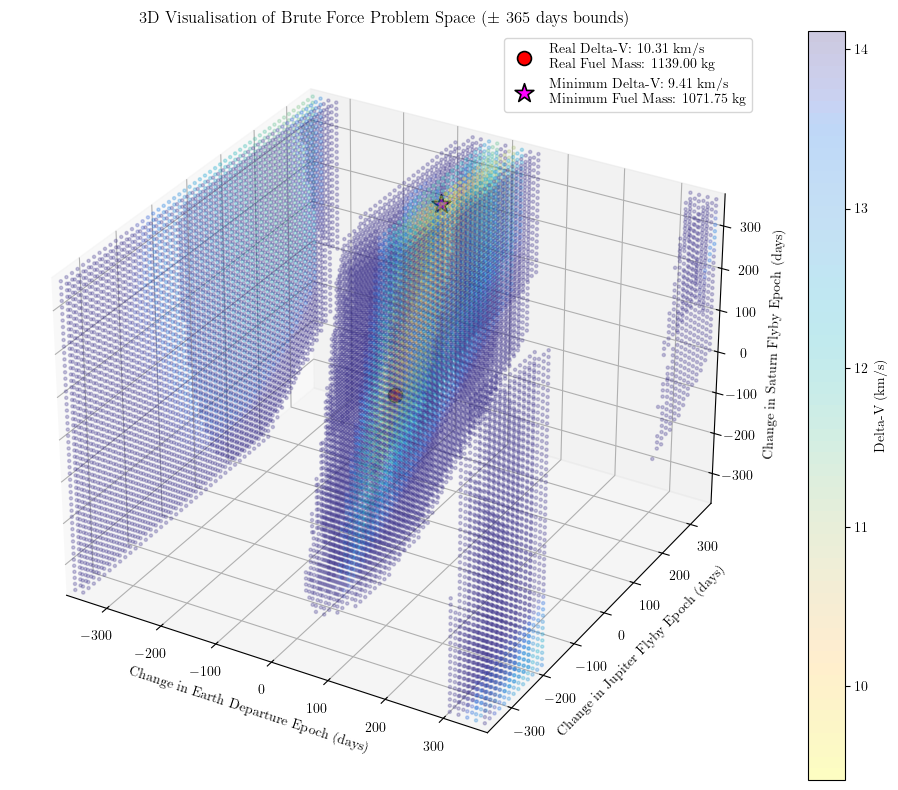

In [87]:
# Filter out any extreme values
max_deltav_threshold = 20  # km/s (adjust as needed)
valid_indices = [i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold]

# Extract valid data
valid_departure_mjd = [departure_mjd_change_in_time[i] for i in valid_indices]
valid_jupiter_mjd = [jupiter_flyby_mjd_change_in_time[i] for i in valid_indices]
valid_saturn_mjd = [saturn_flyby_mjd_change_in_time[i] for i in valid_indices]
valid_deltaV = [deltaV_values[i] for i in valid_indices]

# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Create scatter plot with color based on delta-V 'viridis_r' 'plasma_r' 
scatter = ax.scatter(valid_departure_mjd, valid_jupiter_mjd, valid_saturn_mjd, 
                     c=valid_deltaV, cmap=parula_map(True), s=5, alpha=0.25, 
                     norm=colors.Normalize(vmin=min(valid_deltaV), vmax=min(valid_deltaV) * 1.5))

# Highlight the delta-V points
ax.scatter([0], 
           [0], 
           [0], 
           color='red', s=100, marker='o', edgecolors='black', linewidth=1.2, 
           zorder=3,  # Higher zorder brings it to the front
           label=f'Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg')

ax.scatter([date_departure_mjd_BRUTE_MIN - date_departure_mjd], 
           [date_flyby_jupiter_mjd_BRUTE_MIN - date_flyby_jupiter_mjd], 
           [date_flyby_saturn_mjd_BRUTE_MIN - date_flyby_saturn_mjd], 
           color='fuchsia', s=200, marker='*', edgecolors='black', linewidth=1.2, 
           zorder=3,  # Higher zorder brings it to the front
           label=f'Minimum Delta-V: {deltaV_BRUTE_MIN:.2f} km/s\nMinimum Fuel Mass: {fuel_mass_BRUTE_MIN:.2f} kg')


# Add colorbar
cbar = plt.colorbar(scatter, ax=ax, label='Delta-V (km/s)')

# Set labels and title
ax.set_xlabel('Change in Earth Departure Epoch (days)')
ax.set_ylabel('Change in Jupiter Flyby Epoch (days)')
ax.set_zlabel('Change in Saturn Flyby Epoch (days)')
ax.set_title('3D Visualisation of Brute Force Problem Space ($\pm$ 365 days bounds)')

# Set axis limits
limit = 375
ax.set_xlim(-limit, limit)
ax.set_ylim(-limit, limit)
ax.set_zlim(-limit, limit)

# Add a legend
ax.legend(loc = "best")

# Show both plots
plt.tight_layout()
plt.savefig("voyager_I_brute_force_contour_3D.png", dpi=500, bbox_inches="tight")
#plt.savefig("voyager_cdrute_force_contour_3D.svg", format="svg", dpi=500, bbox_inches="tight")
#ax.view_init(elev=30, azim=45)  # Adjust elevation & azimuth for a better view
plt.show()

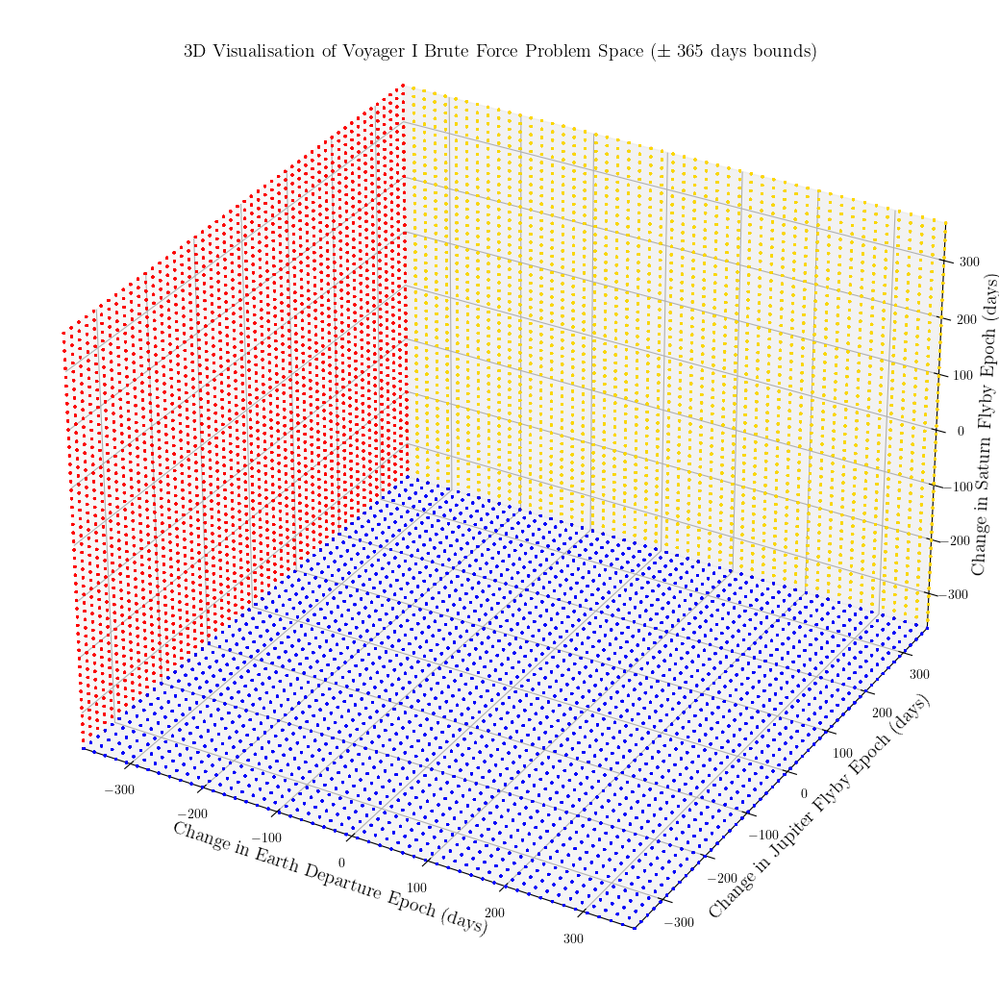

In [88]:
valid_departure_mjd = np.array(departure_mjd_change_in_time)
valid_jupiter_mjd = np.array(jupiter_flyby_mjd_change_in_time)
valid_saturn_mjd = np.array(saturn_flyby_mjd_change_in_time)
limit = 365

# Create figure with adjusted layout
plt.close('all')  # Close any existing plots
fig = plt.figure(figsize=(15, 12), constrained_layout=False)
plt.subplots_adjust(top=0.9, bottom=0.05)  # Adjust top and bottom margins

# Set LaTeX and serif font
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Create 3D axes
ax = fig.add_subplot(111, projection='3d')

# X-Y Plane (Blue) Scatter and Surface
ax.scatter(valid_departure_mjd, valid_jupiter_mjd, -limit, color='blue', s=1, alpha=0.4)
grid_x, grid_y = np.mgrid[min(valid_departure_mjd):max(valid_departure_mjd):50j, 
                           min(valid_jupiter_mjd):max(valid_jupiter_mjd):50j]
grid_z = np.full_like(grid_x, -limit)
#ax.plot_surface(grid_x, grid_y, grid_z, color='blue', alpha=0.2)

# Y-Z Plane (Red) Scatter and Surface
ax.scatter(-limit, valid_jupiter_mjd, valid_saturn_mjd, color='red', s=1, alpha=0.4)
grid_y, grid_z = np.mgrid[min(valid_jupiter_mjd):max(valid_jupiter_mjd):50j, 
                           min(valid_saturn_mjd):max(valid_saturn_mjd):50j]
grid_x = np.full_like(grid_y, -limit)
#ax.plot_surface(grid_x, grid_y, grid_z, color='red', alpha=0.2)

# X-Z Plane (Gold) Scatter and Surface
ax.scatter(valid_departure_mjd, limit, valid_saturn_mjd, color='gold', s=1, alpha=0.4)
grid_x, grid_z = np.mgrid[min(valid_departure_mjd):max(valid_departure_mjd):50j, 
                           min(valid_saturn_mjd):max(valid_saturn_mjd):50j]
grid_y = np.full_like(grid_x, limit)
#ax.plot_surface(grid_x, grid_y, grid_z, color='gold', alpha=0.2)

# Set labels and title with reduced spacing
ax.set_xlabel('Change in Earth Departure Epoch (days)', labelpad=2, fontsize=14)
ax.set_ylabel('Change in Jupiter Flyby Epoch (days)', labelpad=2, fontsize=14)
ax.set_zlabel('Change in Saturn Flyby Epoch (days)', labelpad=2, fontsize=14)
ax.set_title('3D Visualisation of Voyager I Brute Force Problem Space ($\pm$ 365 days bounds)', 
             fontsize=14, pad=10, y=1.02)  # Slight vertical adjustment

# Set axis limits
ax.set_xlim(-limit, limit)
ax.set_ylim(-limit, limit)
ax.set_zlim(-limit, limit)

# Save and show plot
plt.savefig("voyager_I_brute_force_problem_space.png", dpi=500, bbox_inches="tight", pad_inches=0.2)
plt.show()

In [89]:
T_real = 0
sampling_list = []
K=55
DeltaT = (2*365)/K  # 14.6 #days

for num in range(0,K+1):
    sampling_list.append(T_real - (K/2 - num)*(DeltaT))

#sampling_list

In [90]:
T_real = 0
bound = 365
sampling_list = []
K=50
DeltaT = (2*bound)/K  # 14.6 #days

for k in range(0,K+1):
    sampling_list.append( (T_real - bound) + k*(DeltaT))

len(sampling_list)

51

### 1.5) Fixing a Date for Problem Space 2D Contour

In [92]:
%%time
def optimize_trajectory(fix_parameter, spacing=50):
    
    # Validate input parameter
    if fix_parameter not in ['departure', 'jupiter', 'saturn']:
        raise ValueError("Not vaild Input.")

    time_range_LIST = np.linspace(-change_in_time_days, change_in_time_days, spacing)
    
    # Lists to store results
    deltaV_list = []
    time_range_list_index = []
    dates_list = []
    
    # Start timing
    start_time = time.time()
    
    # Determine which loops to run based on fixed parameter
    if fix_parameter == 'departure':
        # Fix departure date, vary Jupiter and Saturn
        for j in range(spacing):
            date_flyby_jupiter_mjd_BRUTE = date_flyby_jupiter_mjd + time_range_LIST[j]
            for k in range(spacing):
                date_flyby_saturn_mjd_BRUTE = date_flyby_saturn_mjd + time_range_LIST[k]
                time_range_list_index.append([0, j, k])
                try:
                    deltaV_mission = find_deltaV_mission(
                        date_departure_mjd,
                        date_flyby_jupiter_mjd_BRUTE,
                        date_flyby_saturn_mjd_BRUTE
                    )
                    deltaV_list.append(deltaV_mission)
                    dates_list.append([
                        date_departure_mjd,
                        date_flyby_jupiter_mjd_BRUTE,
                        date_flyby_saturn_mjd_BRUTE,
                        deltaV_mission
                    ])
                except Exception:
                    deltaV_list.append([1e99, 1e99, {'temp': 1e99}])
    
    elif fix_parameter == 'jupiter':
        # Fix Jupiter flyby date, vary departure and Saturn
        for i in range(spacing):
            date_departure_mjd_BRUTE = date_departure_mjd + time_range_LIST[i]
            for k in range(spacing):
                date_flyby_saturn_mjd_BRUTE = date_flyby_saturn_mjd + time_range_LIST[k]
                time_range_list_index.append([i, 0, k])
                try:
                    deltaV_mission = find_deltaV_mission(
                        date_departure_mjd_BRUTE,
                        date_flyby_jupiter_mjd,
                        date_flyby_saturn_mjd_BRUTE
                    )
                    deltaV_list.append(deltaV_mission)
                    dates_list.append([
                        date_departure_mjd_BRUTE,
                        date_flyby_jupiter_mjd,
                        date_flyby_saturn_mjd_BRUTE,
                        deltaV_mission
                    ])
                except Exception:
                    deltaV_list.append([1e99, 1e99, {'temp': 1e99}])
    
    else:  # fix_parameter == 'saturn'
        # Fix Saturn flyby date, vary departure and Jupiter
        for i in range(spacing):
            date_departure_mjd_BRUTE = date_departure_mjd + time_range_LIST[i]
            for j in range(spacing):
                date_flyby_jupiter_mjd_BRUTE = date_flyby_jupiter_mjd + time_range_LIST[j]
                time_range_list_index.append([i, j, 0])
                try:
                    deltaV_mission = find_deltaV_mission(
                        date_departure_mjd_BRUTE,
                        date_flyby_jupiter_mjd_BRUTE,
                        date_flyby_saturn_mjd
                    )
                    deltaV_list.append(deltaV_mission)
                    dates_list.append([
                        date_departure_mjd_BRUTE,
                        date_flyby_jupiter_mjd_BRUTE,
                        date_flyby_saturn_mjd,
                        deltaV_mission
                    ])
                except Exception:
                    deltaV_list.append([1e99, 1e99, {'temp': 1e99}])
    
    # End timing
    end_time = time.time()
    execution_time = end_time - start_time
    
    # Find minimum deltaV
    min_index = deltaV_list.index(min(deltaV_list, key=lambda x: x[0]))
    deltaV_BRUTE_MIN_2D, fuel_mass_BRUTE_MIN_2D, data_dict_BRUTE_MIN_2D = deltaV_list[min_index]
    
    # Get the time changes that gave minimum deltaV
    change_in_time = time_range_list_index[min_index]
    
    # Calculate the actual dates for minimum deltaV
    best_dates_BRUTE_MIN_2D = [
        date_departure_mjd + time_range_LIST[change_in_time[0]],
        date_flyby_jupiter_mjd + time_range_LIST[change_in_time[1]],
        date_flyby_saturn_mjd + time_range_LIST[change_in_time[2]]
    ]
    
    # Prepare data for plotting
    plot_data = {
        'dates_list': dates_list,
        'time_range_LIST': time_range_LIST,
        'fix_parameter': fix_parameter
    }

    return best_dates_BRUTE_MIN_2D, deltaV_BRUTE_MIN_2D, fuel_mass_BRUTE_MIN_2D, data_dict_BRUTE_MIN_2D, execution_time, plot_data

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 15.3 µs


/var/folders/ts/2k06pkqj7sqgrljsl3sdbxc80000gn/T/ipykernel_15958/4231714446.py:20: RuntimeWarning: overflow encountered in cosh
  return (np.cosh(np.sqrt(-z)) - 1) / (-z)
/var/folders/ts/2k06pkqj7sqgrljsl3sdbxc80000gn/T/ipykernel_15958/4231714446.py:29: RuntimeWarning: overflow encountered in sinh
  return (np.sinh(np.sqrt(-z)) - np.sqrt(-z)) / ((-z) ** 1.5)
/var/folders/ts/2k06pkqj7sqgrljsl3sdbxc80000gn/T/ipykernel_15958/4231714446.py:37: RuntimeWarning: invalid value encountered in scalar divide
  return max(r1 + r2 + A * (z * S(z) - 1) / np.sqrt(C_z), 1e-8)


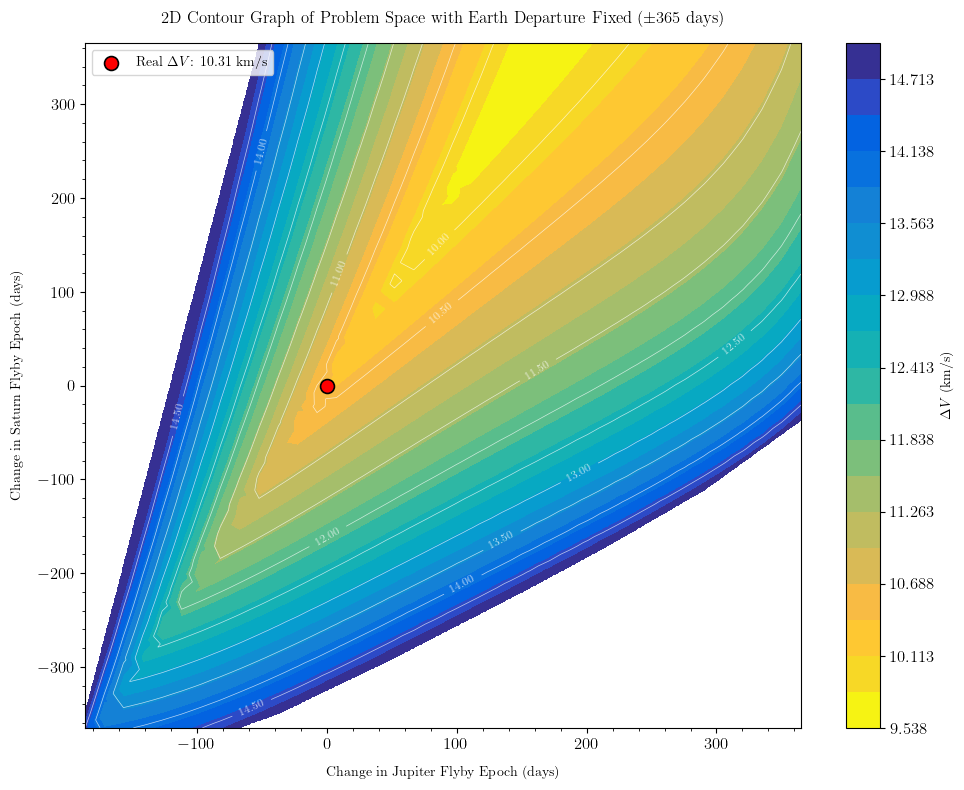

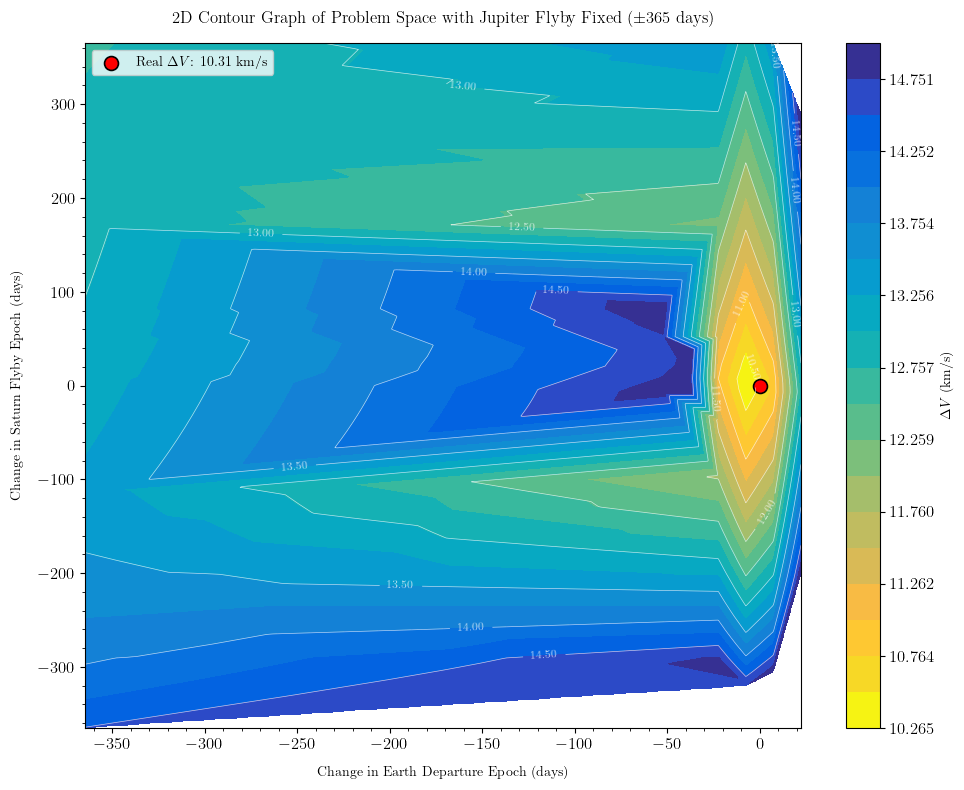

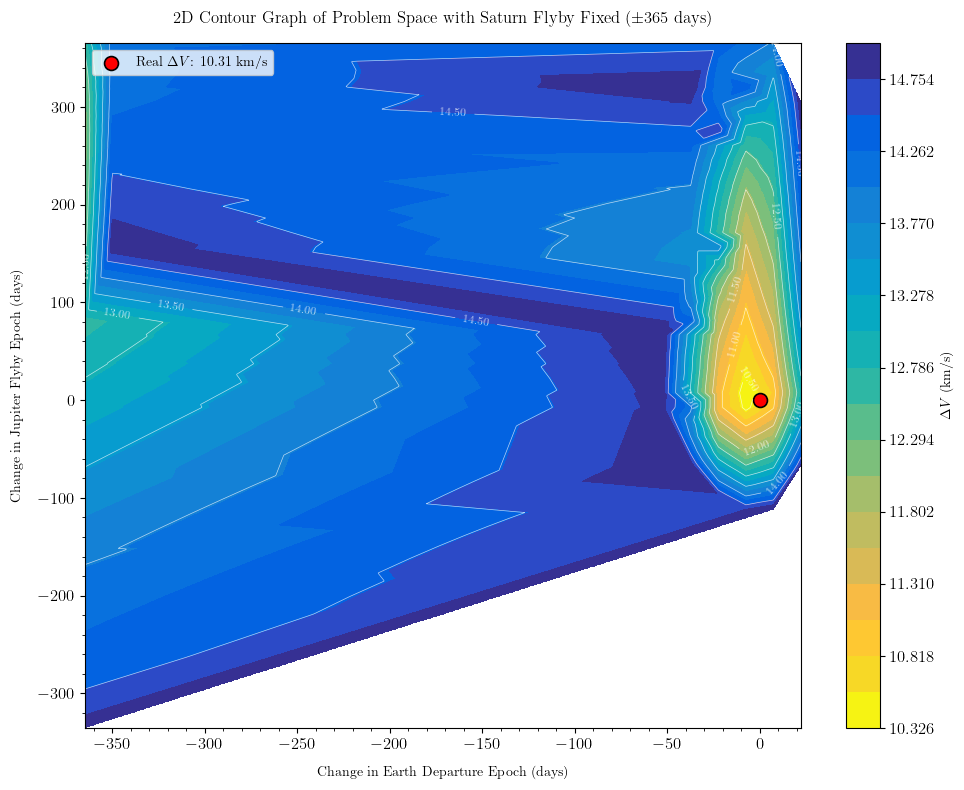

In [93]:
def plot_optimization_results(plot_data, max_deltav_threshold=15):
    
    dates_list = plot_data['dates_list']
    fix_parameter = plot_data['fix_parameter']
    
    # Determine the x and y axis parameters based on fixed parameter
    if fix_parameter == 'departure':
        x_label = 'Change in Jupiter Flyby Epoch (days)'
        y_label = 'Change in Saturn Flyby Epoch (days)'
        title = '2D Contour Graph of Problem Space with Earth Departure Fixed ($\pm$365 days)'
        x_mjd_ref = date_flyby_jupiter_mjd
        y_mjd_ref = date_flyby_saturn_mjd
        x_index = 1
        y_index = 2
    elif fix_parameter == 'jupiter':
        x_label = 'Change in Earth Departure Epoch (days)'
        y_label = 'Change in Saturn Flyby Epoch (days)'
        title = '2D Contour Graph of Problem Space with Jupiter Flyby Fixed ($\pm$365 days)'
        x_mjd_ref = date_departure_mjd
        y_mjd_ref = date_flyby_saturn_mjd
        x_index = 0
        y_index = 2
    else:  # fix_parameter == 'saturn'
        x_label = 'Change in Earth Departure Epoch (days)'
        y_label = 'Change in Jupiter Flyby Epoch (days)'
        title = '2D Contour Graph of Problem Space with Saturn Flyby Fixed ($\pm$365 days)'
        x_mjd_ref = date_departure_mjd
        y_mjd_ref = date_flyby_jupiter_mjd
        x_index = 0
        y_index = 1
    
    # Extract x, y, and deltaV values
    x_mjd = [dates_list[num][x_index] for num in range(len(dates_list))]
    y_mjd = [dates_list[num][y_index] for num in range(len(dates_list))]
    deltaV_values = [dates_list[num][3][0] for num in range(len(dates_list))]
    
    # Convert to change in days
    x_mjd_change = [(element - x_mjd_ref) for element in x_mjd]
    y_mjd_change = [(element - y_mjd_ref) for element in y_mjd]
    
    # Filter out invalid values (too high deltaV)
    valid_indices = [i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold]
    
    # Extract valid data
    valid_x_mjd = [x_mjd_change[i] for i in valid_indices]
    valid_y_mjd = [y_mjd_change[i] for i in valid_indices]
    valid_deltaV = [deltaV_values[i] for i in valid_indices]
    
    # Grid sizes for interpolation
    x_range = np.linspace(min(valid_x_mjd), max(valid_x_mjd), 1000)
    y_range = np.linspace(min(valid_y_mjd), max(valid_y_mjd), 1000)
    
    # Create meshgrid
    X, Y = np.meshgrid(x_range, y_range)
    
    # Interpolate deltaV values to the grid using linear interpolation
    Z = griddata((valid_x_mjd, valid_y_mjd), valid_deltaV, (X, Y), method='linear')
    
    # Create the contour plot
    fig, ax = plt.subplots(figsize=(10, 8))
    
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')
    
    cmap = parula_map(True)
    
    # Define contour levels within the specified range
    min_deltav = np.nanmin(Z)
    levels = np.linspace(min_deltav, max_deltav_threshold, 20)
    
    # Create filled contour plot
    contour = ax.contourf(X, Y, Z, levels=levels, cmap=cmap, 
                          norm=colors.Normalize(vmin=min_deltav, vmax=max_deltav_threshold))
    
    # Add colorbar
    cbar = plt.colorbar(contour, ax=ax, label=r'$\Delta V$ (km/s)')
    cbar.ax.tick_params(labelsize=12)
    
    # Add contour lines
    contour_lines = ax.contour(X, Y, Z, levels=10, colors='white', linewidths=0.5, alpha=0.7)
    ax.clabel(contour_lines, inline=True, fontsize=8, fmt='%.2f')
    
    # Find minimum deltaV point
    min_idx = valid_deltaV.index(min(valid_deltaV))
    min_x = valid_x_mjd[min_idx]
    min_y = valid_y_mjd[min_idx]
    min_dv = valid_deltaV[min_idx]
    
    # Plot original and minimum deltaV points
    ax.scatter(0, 0, color='red', s=100, marker='o', edgecolors='black', linewidth=1.2, 
           label=r'Real $\Delta V$: {:.2f} km/s'.format(deltaV_REAL))
    
    #ax.scatter(min_x, min_y, color='fuchsia', s=200, marker='*', edgecolors='black', linewidth=1.2,
    #          label=f'Minimum $\Delta V$: {min_dv:.2f} km/s')
    
    ax.set_xlabel(x_label, labelpad=10)
    ax.set_ylabel(y_label, labelpad=10)
    ax.set_title(title, pad=15)
    
    ax.minorticks_on()
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.tick_params(axis='both', which='minor', labelsize=10)

    #plt.xlim(-365,365)
    #plt.ylim(-365,365)
    
    plt.legend(loc='upper left')
    
    plt.tight_layout()
    
    os.makedirs("V1", exist_ok=True)
    filename = os.path.join("V1", f"voyager_1_brute_force_{fix_parameter}_fixed_2D.png")
    plt.savefig(filename, dpi=500, bbox_inches="tight")

    plt.show()

fix_parameter="departure"

BRUTE_MIN_2D_fixed_departure = optimize_trajectory("departure", 50)
BRUTE_MIN_2D_fixed_jupiter = optimize_trajectory("jupiter", 50)
BRUTE_MIN_2D_fixed_saturn = optimize_trajectory("saturn", 50)

plot_optimization_results(BRUTE_MIN_2D_fixed_departure[-1], 15)
plot_optimization_results(BRUTE_MIN_2D_fixed_jupiter[-1], 15)
plot_optimization_results(BRUTE_MIN_2D_fixed_saturn[-1], 15)

---
## Fmin Numerical Method

https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.fmin.html

https://jasoncantarella.com/downloads/NelderMeadProof.pdf

In [95]:
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

In [96]:
# Initialize an empty list to store the iterations
iterations = []

# Initial guess
initial_guess = np.array([date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd])

def objective_function(dates):
    # Ensure dates stay within ±365 days of the initial guess
    date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd = dates

    # Ensure dates stay within ±365 days of the initial guess
    lower_bound = initial_guess - 365
    upper_bound = initial_guess + 365
    
    # Check if any value is outside bounds
    if np.any(dates < lower_bound) or np.any(dates > upper_bound):
        deltaV = 1e99
    else:
        try:
            deltaV, fuel_mass, data_dict = find_deltaV_mission(date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd)
            
            # Store the current iteration (dates)
            iterations.append(dates.copy())
        except Exception:
            deltaV = 1e99  # Assign a high penalty for invalid solutions
        
    return deltaV  # Minimise Delta-V

# Start timing
start_time = time.time()

# Run optimization using `fmin` with manual bounds enforcement
optimal_dates = fmin(objective_function, initial_guess, disp=True)

# Extract optimized dates
date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN = optimal_dates

# Compute Delta-V and fuel mass at optimized dates
deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN = find_deltaV_mission(date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN)

# Display results
print(f"Minimum Delta-V: {deltaV_FMIN:.4f} km/s")
print(f"Optimal Departure Date (MJD): {date_departure_mjd_FMIN:.2f}")
print(f"Optimal Jupiter Flyby Date (MJD): {date_flyby_jupiter_mjd_FMIN:.2f}")
print(f"Optimal Saturn Flyby Date (MJD): {date_flyby_saturn_mjd_FMIN:.2f}")

# Convert to calendar dates
print("\nIn calendar dates:")
print(f"Departure: {MJD_to_TT_calander_date(date_departure_mjd_FMIN)}")
print(f"Jupiter flyby: {MJD_to_TT_calander_date(date_flyby_jupiter_mjd_FMIN)}")
print(f"Saturn flyby: {MJD_to_TT_calander_date(date_flyby_saturn_mjd_FMIN)}")

# End timing
end_time = time.time()
execution_time_FMIN = end_time - start_time
print(f"\nExecution Time: {execution_time_FMIN:.4f} seconds")

Optimization terminated successfully.
         Current function value: 9.388030
         Iterations: 201
         Function evaluations: 363
Minimum Delta-V: 9.3880 km/s
Optimal Departure Date (MJD): 43388.37
Optimal Jupiter Flyby Date (MJD): 44099.45
Optimal Saturn Flyby Date (MJD): 44920.99

In calendar dates:
Departure: 1977-09-02 08:54:49.416
Jupiter flyby: 1979-08-14 10:52:57.591
Saturn flyby: 1981-11-12 23:45:59.999

Execution Time: 1.0659 seconds


In [97]:
#iterations

In [98]:
deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN = find_deltaV_mission(date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN)
deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN

(9.388030073904538,
 1069.9564197303307,
 {'deltaV_injection (km/s)': 9.388030073866002,
  'deltaV_jupiter (km/s)': 3.8536285273949034e-11,
  'rp_jupiter (km)': 848168.1721327668,
  'tof (days)': 1532.6188724847307})

In [99]:
print("Earth-Jupiter:",date_flyby_jupiter_mjd_FMIN - date_departure_mjd_FMIN,"days")
print("Jupiter-Saturn:",date_flyby_saturn_mjd_FMIN - date_flyby_jupiter_mjd_FMIN,"days")

Earth-Jupiter: 711.0820390666777 days
Jupiter-Saturn: 821.536833418053 days


In [100]:
dates_list_FMIN = [date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN]
dates_list_FMIN

[43388.371405276324, 44099.453444343, 44920.990277761055]

In [101]:
change_in_dates_list_FMIN = [
    (date_departure_mjd - date_departure_mjd_FMIN),
    (date_flyby_jupiter_mjd - date_flyby_jupiter_mjd_FMIN),
    (date_flyby_saturn_mjd - date_flyby_saturn_mjd_FMIN)
]
change_in_dates_list_FMIN

[6.009150279365713, -161.94997212098679, -364.99999998316343]

In [102]:
date_departure_FMIN = MJD_to_TT_calander_date(date_departure_mjd_FMIN)
date_flyby_jupiter_FMIN = MJD_to_TT_calander_date(date_flyby_jupiter_mjd_FMIN)
date_flyby_saturn_FMIN = MJD_to_TT_calander_date(date_flyby_saturn_mjd_FMIN)

print("Date of Departure (Min):", MJD_to_TT_calander_date(date_departure_mjd_FMIN))

print("Date of Jupiter Flyby (Min):", MJD_to_TT_calander_date(date_flyby_jupiter_mjd_FMIN))

print("Date of Saturn Flyby (Min):", MJD_to_TT_calander_date(date_flyby_saturn_mjd_FMIN))

Date of Departure (Min): 1977-09-02 08:54:49.416
Date of Jupiter Flyby (Min): 1979-08-14 10:52:57.591
Date of Saturn Flyby (Min): 1981-11-12 23:45:59.999


### Contour Graph of Problem Space

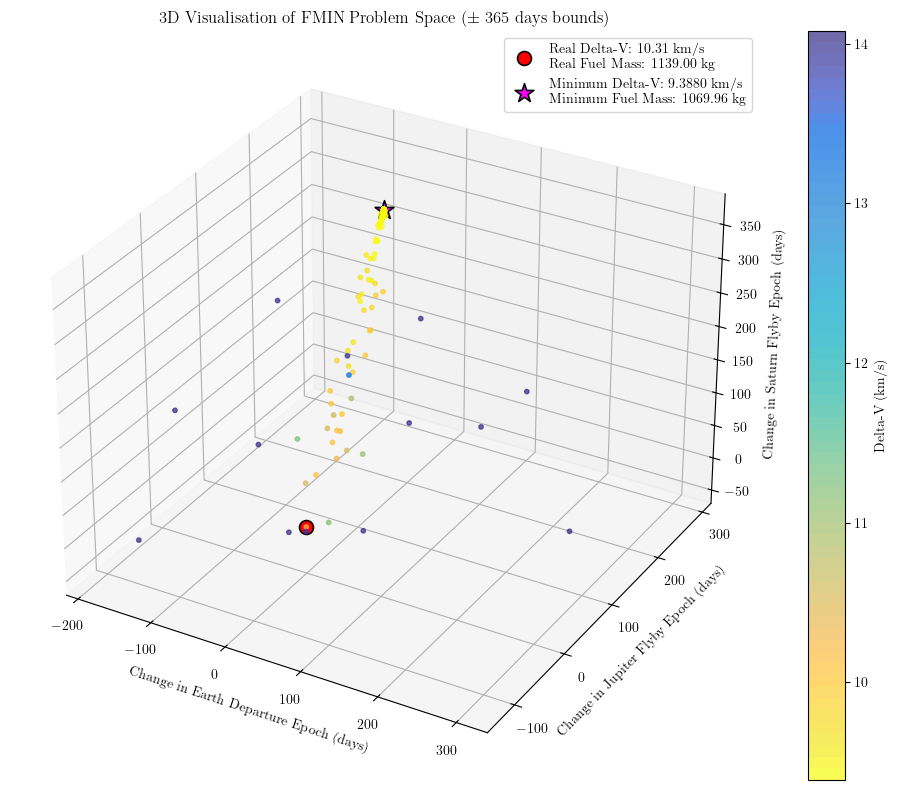

In [104]:
# Extract the dates from the iterations list
departure_dates_FMIN = np.array([iter[0] for iter in iterations])
jupiter_flyby_dates_FMIN = np.array([iter[1] for iter in iterations])
saturn_flyby_dates_FMIN = np.array([iter[2] for iter in iterations])

# Calculate the corresponding deltaV values for the iterations
deltaV_values_FMIN = []
for dates in iterations:
    try:
        deltaV, _, _ = find_deltaV_mission(*dates)
    except Exception:
        deltaV_values_FMIN.append(1e99)
        continue
    deltaV_values_FMIN.append(deltaV)

# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Scatter plot with color based on deltaV
scatter = ax.scatter(departure_dates_FMIN - date_departure_mjd, jupiter_flyby_dates_FMIN - date_flyby_jupiter_mjd, saturn_flyby_dates_FMIN - date_flyby_saturn_mjd, 
                     c=deltaV_values_FMIN, cmap=parula_map(True), s=10, alpha=0.7, 
                     norm=plt.Normalize(vmin=min(deltaV_values_FMIN), vmax=min(deltaV_values_FMIN) * 1.5))

#ax.plot(departure_dates_FMIN - date_departure_mjd, jupiter_flyby_dates_FMIN - date_flyby_jupiter_mjd, saturn_flyby_dates_FMIN - date_flyby_saturn_mjd,
#        linestyle='-', color='g', markersize=6, linewidth=0.5, alpha=0.5)

ax.scatter([0], 
           [0], 
           [0], 
           color='red', s=100, marker='o', edgecolors='black', linewidth=1.2, 
           zorder=3,  # Higher zorder brings it to the front
           label=f'Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg')

ax.scatter(date_departure_mjd_FMIN - date_departure_mjd, 
           date_flyby_jupiter_mjd_FMIN - date_flyby_jupiter_mjd, 
           date_flyby_saturn_mjd_FMIN - date_flyby_saturn_mjd, 
           color='fuchsia', s=200, marker='*', edgecolors='black', linewidth=1.2, 
           zorder=3,  # Higher zorder brings it to the front
           label=f'Minimum Delta-V: {deltaV_FMIN:.4f} km/s\nMinimum Fuel Mass: {fuel_mass_FMIN:.2f} kg')


# Add colorbar
cbar = plt.colorbar(scatter, ax=ax, label='Delta-V (km/s)')

# Set labels and title
ax.set_xlabel('Change in Earth Departure Epoch (days)')
ax.set_ylabel('Change in Jupiter Flyby Epoch (days)')
ax.set_zlabel('Change in Saturn Flyby Epoch (days)')
ax.set_title('3D Visualisation of FMIN Problem Space ($\pm$ 365 days bounds)')

ax.legend(loc = "best")

# Set axis limits
# limit = 375
# ax.set_xlim(-limit, limit)
# ax.set_ylim(-limit, limit)
# ax.set_zlim(-limit, limit)

# Show the plot
plt.tight_layout()
plt.savefig("voyager_I_fmin_contour_3D.png", dpi=500, bbox_inches="tight")

plt.show()

In [105]:
#find_deltaV_mission(departure_dates[-1], jupiter_flyby_dates[-1], saturn_flyby_dates[-1])
change_in_dates_list_FMIN

[6.009150279365713, -161.94997212098679, -364.99999998316343]

---
## Genetic Algorithm (GA)

In [107]:
min_departure_date = date_departure_mjd - change_in_time_days 
max_departure_date = date_departure_mjd + change_in_time_days

min_flyby_jupiter = date_flyby_jupiter_mjd - change_in_time_days
max_flyby_jupiter = date_flyby_jupiter_mjd + change_in_time_days

min_flyby_saturn = date_flyby_saturn_mjd - change_in_time_days 
max_flyby_saturn = date_flyby_saturn_mjd + change_in_time_days  

### Step 1: Generate Initial Population

In [109]:
def initial_population(n_population):
    # Generates initial population within mission constraints.
    population = []
    population.append(dates_REAL)

    # Add interval to generate population
    for num in range(n_population-1):
        date_departure_pop = random.uniform(min_departure_date, max_departure_date)
        date_flyby_jupiter_pop = random.uniform(min_flyby_jupiter, max_flyby_jupiter)
        date_flyby_saturn_pop = random.uniform(min_flyby_saturn, max_flyby_saturn)

        # Ensure chronological order of mission events
        date_flyby_jupiter_pop = max(date_flyby_jupiter_pop, date_departure_pop)
        date_flyby_saturn_pop = max(date_flyby_saturn_pop, date_flyby_jupiter_pop)

        population.append([date_departure_pop, date_flyby_jupiter_pop, date_flyby_saturn_pop])
    
    return population

#pop = initial_population(2000)

### Step 2: Evaluation [Fitness Function (Objective Function)]

In [111]:
def fitness(individual):
    # Evaluates fitness based on deltaV_total minimisation.
    try:
        date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd = individual
        deltaV, fuel_mass, data_dict = find_deltaV_mission(*individual)
    except Exception:
        deltaV = 1e6 #np.inf  # Assign a large penalty for infeasible solutions

    return 1 / (deltaV + 1e-6)  # Avoid division by zero

#np.array([fitness(ind) for ind in pop])

### Step 3: Sort Population by Fitness

In [113]:
def sort_population_by_fitness(population, fitness_scores, n_population):
    sorted_indices = np.argsort(fitness_scores)[::-1]  # Sort by highest fitness
    population = [population[i] for i in sorted_indices[:n_population]] # Ensures length population is 'n_population' 
    return population   

### Step 4: Elitism (Optional)

In [115]:
def elitism(population, n_elite):
    elite_individuals = population[:n_elite]
    return elite_individuals

### Step 5: Selection

#### Tournament Selection

In [118]:
# def tournament_selection(population, fitness_scores, k=3):
#     # Selects the best individual from a random subset of k individuals.
#     selected_indices = np.random.choice(len(population), k, replace=False)
#     best_index = selected_indices[np.argmax([fitness_scores[i] for i in selected_indices])]
#     return population[best_index]

def tournament_selection(population, fitness_scores, tournament_size=3):
    """
    Select the best individual through tournament selection.
    
    Parameters:
    -----------
    population : array-like
        The population of individuals
    fitness_scores : array-like
        Array of fitness scores for each individual (higher is better)
    tournament_size : int, optional
        Number of individuals to compete in each tournament (default: 3)
        
    Returns:
    --------
    selected_individual : object
        The winning individual from the tournament
    """
    # Select random individuals for the tournament
    selected_indices = np.random.choice(len(population), tournament_size, replace=False)
    
    # Find the best individual in the tournament
    tournament_fitness = [fitness_scores[i] for i in selected_indices]
    winner_idx = selected_indices[np.argmax(tournament_fitness)]
    
    return population[winner_idx]

#### Roulette Wheel Selection

In [120]:
# def roulette_wheel_selection(population, fitness_probs):
#     # Calculate cumulative sum of fitness probabilities
#     cum_sum = fitness_probs.cumsum()
    
#     # Generate a random number between 0 and 1
#     r = np.random.random()
    
#     # Find the first index where cumulative sum exceeds random number
#     selected_index = np.where(cum_sum >= r)[0][0]
    
#     return population[selected_index]

def roulette_wheel_selection(population, fitness_values):
    # Calculate the normalised selection probability for each individual
    selection_prob = fitness_values / sum(fitness_values)
    # Calculate cumulative sum of fitness probabilities
    cum_sum = selection_prob.cumsum()
    # Generate a random number between 0 and 1
    r = random.random()
    # Find the first index where cumulative sum exceeds random number
    selected_index = np.where(cum_sum >= r)[0][0]
    return population[selected_index]

pop = initial_population(20)
# Evaluate fitness function
fitness_scores = np.array([fitness(ind) for ind in pop])        
# Sorts population by fitness value
pop = sort_population_by_fitness(pop, fitness_scores, 20)

roulette_wheel_selection(pop, fitness_scores)

[43705.42578944145, 44126.3306603382, 44611.149425477226]

### Step 6: Crossover

#### Single-Point Crossover

In [123]:
def single_point_crossover(parent_1, parent_2):
    #Performs single-point crossover.
    crossover_point = random.randint(1, 2)
    offspring_1 = parent_1[:crossover_point] + parent_2[crossover_point:]
    offspring_2 = parent_2[:crossover_point] + parent_1[crossover_point:]

    # Ensure chronological order
    offspring_1[1] = max(offspring_1[1], offspring_1[0])
    offspring_1[2] = max(offspring_1[2], offspring_1[1])
    offspring_2[1] = max(offspring_2[1], offspring_2[0])
    offspring_2[2] = max(offspring_2[2], offspring_2[1])

    return offspring_1, offspring_2

#### Simulated Binary Crossover (SBX)

https://pymoo.org/operators/crossover.html

In [125]:
"""
Simulated Binary Crossover (SBX) for real-valued parameters.

Creates offspring that are similar to their parents while allowing
controlled exploration. Popular in space trajectory optimization.

Parameters:
-----------
parent_1, parent_2 : list
    Parent solution with 3 date values [departure, jupiter, saturn]
eta : float
    Distribution index (higher value = offspring closer to parents)
"""

def sbx_crossover(parent_1, parent_2, eta=1.5):
    """ Performs Simulated Binary Crossover (SBX) for continuous variables. """
    offspring_1 = parent_1[:]
    offspring_2 = parent_2[:]
    
    for i in range(len(parent_1)):  
        u = random.random()
        if u <= 0.5:
            beta = (2 * u) ** (1 / (eta + 1))
        else:
            beta = (1 / (2 * (1 - u))) ** (1 / (eta + 1))

        # Generate offspring
        offspring_1[i] = 0.5 * ((1 + beta) * parent_1[i] + (1 - beta) * parent_2[i])
        offspring_2[i] = 0.5 * ((1 - beta) * parent_1[i] + (1 + beta) * parent_2[i])

    # Ensure chronological order (if values represent time-based sequences)
    offspring_1[0] = min(offspring_1[1], offspring_1[0])
    offspring_1[1] = max(offspring_1[1], offspring_1[0])
    offspring_1[2] = max(offspring_1[2], offspring_1[1])
    
    offspring_2[0] = min(offspring_2[1], offspring_2[0])
    offspring_2[1] = max(offspring_2[1], offspring_2[0])
    offspring_2[2] = max(offspring_2[2], offspring_2[1])

    return offspring_1, offspring_2

In [126]:
# # Current Single-Point Crossover 
# def single_point_crossover(parent_1, parent_2):
#     """Performs single-point crossover."""
#     crossover_point = random.randint(1, 2)
#     offspring_1 = parent_1[:crossover_point] + parent_2[crossover_point:]
#     offspring_2 = parent_2[:crossover_point] + parent_1[crossover_point:]
    
#     # Ensure chronological order
#     offspring_1[1] = max(offspring_1[1], offspring_1[0])
#     offspring_1[2] = max(offspring_1[2], offspring_1[1])
#     offspring_2[1] = max(offspring_2[1], offspring_2[0])
#     offspring_2[2] = max(offspring_2[2], offspring_2[1])
    
#     return offspring_1, offspring_2

# # Simulated Binary Crossover (SBX)
# def simulated_binary_crossover(parent_1, parent_2, eta=2):
#     """
#     Simulated Binary Crossover (SBX) for real-valued parameters.
    
#     Creates offspring that are similar to their parents while allowing
#     controlled exploration. Popular in space trajectory optimization.
    
#     Parameters:
#     -----------
#     parent_1, parent_2 : list
#         Parent solution with 3 date values [departure, jupiter, saturn]
#     eta : float
#         Distribution index (higher value = offspring closer to parents)
#     """
#     offspring_1 = []
#     offspring_2 = []
    
#     for i in range(len(parent_1)):
#         # Avoid division by zero and ensure distinctness
#         if abs(parent_1[i] - parent_2[i]) < 1e-10:
#             offspring_1.append(parent_1[i])
#             offspring_2.append(parent_2[i])
#             continue
        
#         # Calculate beta value
#         if random.random() <= 0.5:
#             beta = (2.0 * random.random()) ** (1.0 / (eta + 1.0))
#         else:
#             beta = (1.0 / (2.0 * (1.0 - random.random()))) ** (1.0 / (eta + 1.0))
        
#         # Calculate children
#         offspring_1.append(0.5 * ((1 + beta) * parent_1[i] + (1 - beta) * parent_2[i]))
#         offspring_2.append(0.5 * ((1 - beta) * parent_1[i] + (1 + beta) * parent_2[i]))
    
#     # Ensure chronological order
#     offspring_1[1] = max(offspring_1[1], offspring_1[0])
#     offspring_1[2] = max(offspring_1[2], offspring_1[1])
#     offspring_2[1] = max(offspring_2[1], offspring_2[0])
#     offspring_2[2] = max(offspring_2[2], offspring_2[1])
    
#     return offspring_1, offspring_2

### Step 7: Mutation (Random Perturbations)

In [128]:
# def mutation(individual):
#     # Introduces random perturbations to mission dates.
    
#     mutation_strength = 30  # Days to perturb randomly
#     index = random.randint(0, 2)  # Select random index to mutate
#     individual[index] += random.uniform(-mutation_strength, mutation_strength)

#     # Ensure sequential order
#     individual[1] = max(individual[1], individual[0])
#     individual[2] = max(individual[2], individual[1])

#     return individual

def uniform_mutation(individual):
    """
    Uniform mutation for trajectory optimization.
    Introduces random perturbations to mission dates within a fixed range.
    
    Args:
        individual: List of dates [departure_date, jupiter_flyby_date, saturn_flyby_date]
        
    Returns:
        Mutated individual with updated mission dates
    """
    # Create a copy to avoid modifying the original
    mutated = individual.copy()
    
    # Define mutation strength
    mutation_strength = 30  # Days to perturb randomly
    
    # Select random index to mutate
    index = random.randint(0, 2)
    
    # Apply uniform mutation
    mutated[index] += random.uniform(-mutation_strength, mutation_strength)
    
    # Ensure sequential order
    mutated[0] = min(mutated[1], mutated[0])
    mutated[1] = max(mutated[1], mutated[0])
    mutated[2] = max(mutated[2], mutated[1])
    
    return mutated


def gaussian_mutation(individual):
    """
    Gaussian mutation for trajectory optimization.
    Introduces perturbations to mission dates using a normal distribution.
    
    Args:
        individual: List of dates [departure_date, jupiter_flyby_date, saturn_flyby_date]
        
    Returns:
        Mutated individual with updated mission dates
    """
    # Create a copy to avoid modifying the original
    mutated = individual.copy()
    
    # Define bounds for each parameter
    bounds = [
        (min_departure_date, max_departure_date),
        (min_flyby_jupiter, max_flyby_jupiter),
        (min_flyby_saturn, max_flyby_saturn)
    ]
    
    # Select random index to mutate
    index = random.randint(0, 2)
    
    # Calculate parameter range
    param_range = bounds[index][1] - bounds[index][0]
    
    # Apply Gaussian mutation with standard deviation proportional to parameter range
    sigma = 0.05 * param_range  # 5% of the parameter range
    delta = random.gauss(0, sigma)
    mutated[index] += delta
    
    # Ensure value stays within bounds
    mutated[index] = max(min(mutated[index], bounds[index][1]), bounds[index][0])
    
    # Ensure sequential order
    mutated[0] = min(mutated[1], mutated[0])
    mutated[1] = max(mutated[1], mutated[0])
    mutated[2] = max(mutated[2], mutated[1])
    
    return mutated

### Step 8: Running GA

1. Initialise population
2. Sort population
3. Start Loop
4. Evaluate fitness
5. Select parents (roulette wheel)
6. Crossover (SBX or copy)
7. Mutation
8. Combine Offspring & Elite Individuals
9. Filter for constraints
10. Sort & truncate population 
11. Elitism (store best individuals)
12. Does it satisfy termination condition
13. If NO, then repeat loop. If YES, end loop
14. Store best (optimal) individual solution

In [130]:
def run_genetic_algorithm(n_population, n_elite, crossover_per, mutation_per, n_generations, population_per_generation):
    #n_generations = n_generations + 1
    population = initial_population(n_population) # Generate initial population

    # Evaluate fitness function
    fitness_scores_temp = np.array([fitness(ind) for ind in population])
    # Sorts population by fitness value
    population_temp = sort_population_by_fitness(population, fitness_scores_temp, n_population)
    
    population_per_generation.append(population_temp)
    elite_individuals = []
    
    for generation in range(0, n_generations):
        start_time = time.time()
        # Evaluate fitness function
        fitness_scores = np.array([fitness(ind) for ind in population])
            
        # Sorts population by fitness value
        population = sort_population_by_fitness(population, fitness_scores, n_population)

        # Print progress
        best_individual = population[0]
        best_deltaV, best_fuel_mass, _ = find_deltaV_mission(*best_individual)
        print(f"Generation {generation}: Best Delta-V = {best_deltaV:.6f} km/s, Fitness = {fitness(best_individual):.6f}")
                
        # Apply elitism - preserve the best individuals
        if n_elite != 0:
            elite_individuals = elitism(population, n_elite)
        
        # Select parents for potential crossover - select enough for the whole population
        parents_list = []
        for i in range(n_population):
            parents_list.append(tournament_selection(population, fitness_scores))

        # Perform crossover with crossover probability
        offspring_list = []
        for i in range(0, len(parents_list) - 1, 2):
            # Apply crossover based on crossover probability
            if random.random() < crossover_per:
                offspring_1, offspring_2 = sbx_crossover(parents_list[i], parents_list[i+1])
            else:
                # If no crossover, children are exact copies of parents
                offspring_1, offspring_2 = parents_list[i][:], parents_list[i+1][:]
            
            offspring_list.extend([offspring_1, offspring_2])

        # Perform mutation
        for i in range(len(offspring_list)):
            if random.random() < mutation_per:
                    offspring_list[i] = gaussian_mutation(offspring_list[i])
        
        # Combine elite individuals, parents and offspring
        mixed_population = offspring_list + elite_individuals
        
        # Filter solutions that meet the mission constraints
        mixed_population = [
            ind for ind in mixed_population
            if np.abs(ind[0] - date_departure_mjd) <= change_in_time_days
            and np.abs(ind[1] - date_flyby_jupiter_mjd) <= change_in_time_days
            and np.abs(ind[2] - date_flyby_saturn_mjd) <= change_in_time_days
        ]
        
        # Ensure population is not empty (if all individuals were filtered out)
        if not mixed_population:
            mixed_population = offspring_list + elite_individuals # Restore full population if filtering removed all

        # Ensure population size remains constant (selection 'n_population' best individuals)
        fitness_scores = np.array([fitness(ind) for ind in mixed_population])
        population = sort_population_by_fitness(mixed_population, fitness_scores, n_population)

        # Store current population
        population_per_generation.append(population)

        end_time = time.time()
        #print(end_time - start_time)
    
    # Return the best-found solution
    best_individual = population[0]
    best_list = best_deltaV, best_fuel_mass, best_data = find_deltaV_mission(*best_individual)
    print(f"Generation {n_generations}: Best Delta-V = {best_deltaV:.6f} km/s, Fitness = {fitness(best_individual):.6f}")
    
    print("\nFinal Optimised Solution:")
    print(f"Departure Date (MJD): {best_individual[0]:.2f}")
    print(f"Jupiter Flyby Date (MJD): {best_individual[1]:.2f}")
    print(f"Saturn Flyby Date (MJD): {best_individual[2]:.2f}")
    print(f"Total deltaV: {best_deltaV:.6f} km/s")
    
    return best_individual, best_list, population_per_generation

In [131]:
%%time

if global_flag:
    # n_population = 2000
    # n_elite = 10
    # crossover_per = 0.9
    # mutation_per = 0.3
    # n_generations = 20
    
    n_population = 1500
    n_elite = 10
    crossover_per = 0.9
    mutation_per = 0.35
    n_generations = 50
    
    # n_population = 300
    # n_elite = 10
    # crossover_per = 0.9
    # mutation_per = 0.35
    # n_generations = 50
    
    # Start timing
    start_time = time.time()
    
    # Run the Genetic Algorithm
    best_individual, best_mission_data, population_per_generation = run_genetic_algorithm(n_population, n_elite, crossover_per, mutation_per, n_generations, [])
    print()
    # End timing
    end_time = time.time()
    execution_time_GA = end_time - start_time
    print(f"\nExecution Time: {execution_time_GA:.4f} seconds\n")

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 3.81 µs


In [132]:
# filename_GA = "ga_results_V1.pkl"

# results_GA = {
#     "Best Individual": best_individual,
#     "Best Mission Data": best_mission_data,
#     "Population Per Generation": population_per_generation,
#     "execution_time_GA": execution_time_GA
# }
# with open(filename_GA, "wb") as f:
#     pickle.dump(results_GA, f)

In [133]:
filename_GA = "ga_results_V1.pkl"

with open(filename_GA, "rb") as f:
    data = pickle.load(f)

best_individual = data["Best Individual"]
best_mission_data = data["Best Mission Data"]
population_per_generation = data["Population Per Generation"]
execution_time_GA = data["execution_time_GA"]

In [134]:
best_solutions_per_generation = [element[0] for element in population_per_generation]
best_solutions_per_generation, len(best_solutions_per_generation)

([[43399.63999698075, 44072.61624804157, 44910.76940777467],
  [43399.63999698075, 44072.61624804157, 44910.76940777467],
  [43384.26298259348, 44054.17405524201, 44766.35829205007],
  [43383.135287405625, 44101.301429896055, 44915.49488039751],
  [43388.78512713279, 44086.59163063379, 44873.296253242115],
  [43387.13122053841, 44068.4997813465, 44843.78249350872],
  [43387.80250392768, 44086.58396811462, 44893.7606718333],
  [43387.12775217531, 44099.947502893156, 44920.89994479495],
  [43387.12775217531, 44099.947502893156, 44920.89994479495],
  [43387.12775217531, 44099.947502893156, 44920.89994479495],
  [43387.66611390198, 44096.60904861329, 44914.14111907921],
  [43387.66611390198, 44096.60904861329, 44914.14111907921],
  [43387.68455850909, 44099.92037143411, 44920.99027777789],
  [43387.93923725883, 44099.626699041175, 44920.99027777789],
  [43388.3390306358, 44098.375161324286, 44918.40880138488],
  [43387.70675211807, 44099.29357732815, 44920.79947289025],
  [43387.9278124178

In [135]:
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

### GA Result Analysis

In [137]:
deltaV_GA, fuel_mass_GA, data_dict_GA = find_deltaV_mission(*best_individual)
deltaV_GA, fuel_mass_GA, data_dict_GA

(9.388030090942555,
 1069.9564210491797,
 {'deltaV_injection (km/s)': 9.388030076492688,
  'deltaV_jupiter (km/s)': 1.4449867080656986e-08,
  'rp_jupiter (km)': 848168.1927761217,
  'tof (days)': 1532.6188494168453})

In [138]:
date_departure_mjd_GA = best_individual[0]
date_flyby_jupiter_mjd_GA = best_individual[1]
date_flyby_saturn_mjd_GA = best_individual[2]

dates_list_GA = best_individual
dates_list_GA

[43388.371428361046, 44099.45344502489, 44920.99027777789]

In [139]:
print(f"Difference for date_departure: {date_departure_mjd - date_departure_mjd_GA}")
print(f"Difference for date_flyby_jupiter: {date_flyby_jupiter_mjd - date_flyby_jupiter_mjd_GA}")
print(f"Difference for date_flyby_saturn: {date_flyby_saturn_mjd - date_flyby_saturn_mjd_GA}\n")

change_in_dates_list_GA = [
    (date_departure_mjd - date_departure_mjd_GA),
    (date_flyby_jupiter_mjd - date_flyby_jupiter_mjd_GA),
    (date_flyby_saturn_mjd - date_flyby_saturn_mjd_GA)
]
change_in_dates_list_GA

Difference for date_departure: 6.009127194643952
Difference for date_flyby_jupiter: -161.94997280287498
Difference for date_flyby_saturn: -365.0



[6.009127194643952, -161.94997280287498, -365.0]

In [140]:
print("Earth-Jupiter:",date_flyby_jupiter_mjd_GA - date_departure_mjd_GA,"days")
print("Jupiter-Saturn:",date_flyby_saturn_mjd_GA - date_flyby_jupiter_mjd_GA,"days")

Earth-Jupiter: 711.0820166638441 days
Jupiter-Saturn: 821.5368327530014 days


In [141]:
date_departure_GA = MJD_to_TT_calander_date(date_departure_mjd_GA)
date_flyby_jupiter_GA = MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA)
date_flyby_saturn_GA = MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA)

print("Date of Departure (Min):", MJD_to_TT_calander_date(date_departure_mjd_GA))

print("Date of Jupiter Flyby (Min):", MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA))

print("Date of Saturn Flyby (Min):", MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA))

print([date_departure_GA, date_flyby_jupiter_GA, date_flyby_saturn_GA])

Date of Departure (Min): 1977-09-02 08:54:51.410
Date of Jupiter Flyby (Min): 1979-08-14 10:52:57.650
Date of Saturn Flyby (Min): 1981-11-12 23:46:00.000
['1977-09-02 08:54:51.410', '1979-08-14 10:52:57.650', '1981-11-12 23:46:00.000']


#### Objective Function vs No. of Generations

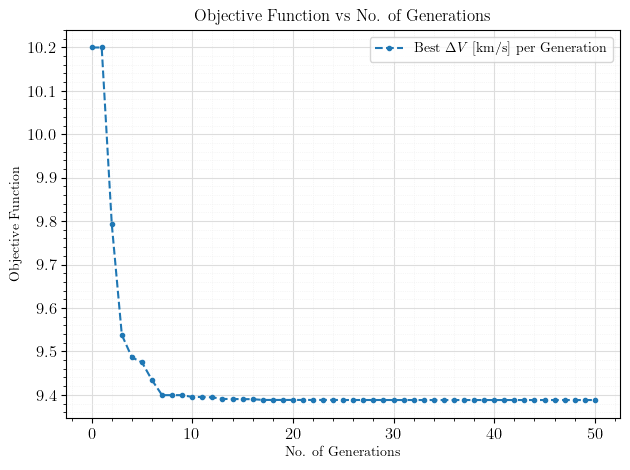

In [143]:
generations = list(range(len(best_solutions_per_generation)))  # X-axis (Generation numbers)
deltaV_values_GA = []  # Y-axis (Best Delta V per generation)
fuel_mass_values = []

for solution in best_solutions_per_generation:
    best_deltaV, best_fuel_mass, _ = find_deltaV_mission(*solution)  # Compute Delta V for each best solution
    deltaV_values_GA.append(best_deltaV)
    fuel_mass_values.append(best_fuel_mass)

# Plot the data
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

fig, ax = plt.subplots()

plt.plot(generations[:], deltaV_values_GA[:], marker='.', linestyle='--', label="Best $\Delta V$ [km/s] per Generation")
#plt.plot(generations[:], fuel_mass_values[:], marker='.', linestyle='--', label="Best Fuel Mass $(M_f)$ [kg] per Generation")

plt.xlabel("No. of Generations")
plt.ylabel("Objective Function")

plt.title("Objective Function vs No. of Generations")

plt.legend(loc="best")

# Improve grid and ticks
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax.minorticks_on()

# Customize tick parameters
ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=10)

plt.tight_layout()

# Show plot
plt.show()

#### Fitness Function vs No. of Generations

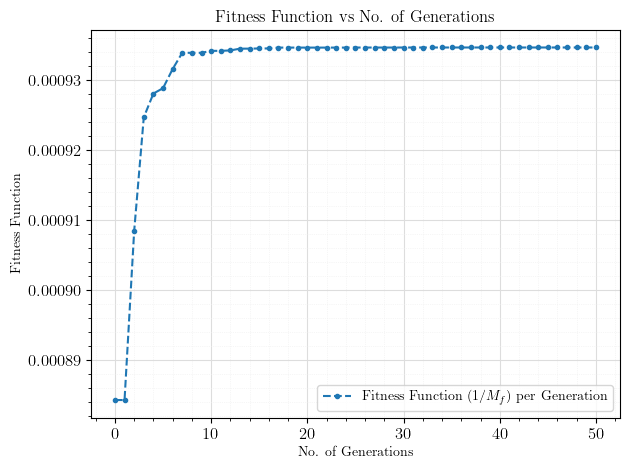

In [145]:
fitness_values_deltaV = 1/np.array(deltaV_values_GA)
fitness_values_fuel_mass = 1/np.array(fuel_mass_values)

# Plot the data
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

fig, ax = plt.subplots()

#plt.plot(generations, fitness_values_deltaV, marker='.', linestyle='--', label="Fitness Function $(1/\Delta V)$ per Generation")
plt.plot(generations, fitness_values_fuel_mass, marker='.', linestyle='--', label="Fitness Function $(1/M_f)$ per Generation")

plt.xlabel("No. of Generations")
plt.ylabel("Fitness Function")

plt.title("Fitness Function vs No. of Generations")

plt.legend(loc="best")

# Improve grid and ticks
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax.minorticks_on()

# Customize tick parameters
ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=10)

plt.tight_layout()

# Show plot
plt.show()

In [146]:
GA_list = [date_departure_mjd_GA, date_flyby_jupiter_mjd_GA, date_flyby_saturn_mjd_GA]
GA_list_calendar = [date_departure_GA, date_flyby_jupiter_GA, date_flyby_saturn_GA]
GA_list, GA_list_calendar

([43388.371428361046, 44099.45344502489, 44920.99027777789],
 ['1977-09-02 08:54:51.410',
  '1979-08-14 10:52:57.650',
  '1981-11-12 23:46:00.000'])

#### Contour Graph per Generation

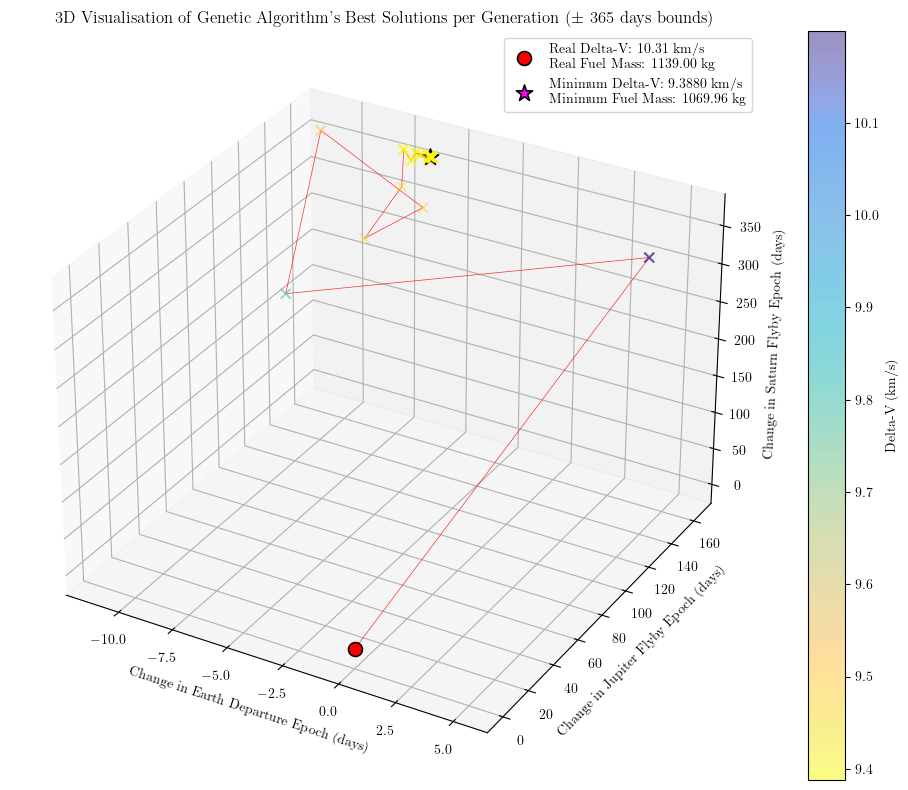

In [148]:
# Extract best solutions per generation
best_solutions = np.array(best_solutions_per_generation)

departure_dates = best_solutions[:, 0] - date_departure_mjd
jupiter_flyby_dates = best_solutions[:, 1] - date_flyby_jupiter_mjd
saturn_flyby_dates = best_solutions[:, 2] - date_flyby_saturn_mjd

# Compute deltaV for colour mapping
deltaV_values_GA = np.array([find_deltaV_mission(*sol)[0] for sol in best_solutions])

# Create figure
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot of best solutions per generation
scatter = ax.scatter(departure_dates, jupiter_flyby_dates, saturn_flyby_dates,
                     c=deltaV_values_GA, cmap=parula_map(True), s=50, alpha=0.5, marker='x',
                     norm=plt.Normalize(vmin=min(deltaV_values_GA), vmax=max(deltaV_values_GA)))

ax.scatter([0], 
           [0], 
           [0], 
           color='red', s=100, marker='o', edgecolors='black', linewidth=1.2, 
           zorder=3,  # Higher zorder brings it to the front
           label=f'Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg')

ax.plot([0, departure_dates[0]], 
        [0, jupiter_flyby_dates[0]], 
        [0, saturn_flyby_dates[0]], 
        linestyle='-', color='r', markersize=6, linewidth=0.5, alpha=0.8)

ax.plot(departure_dates, jupiter_flyby_dates, saturn_flyby_dates, linestyle='-', color='r', markersize=6, linewidth=0.5, alpha=0.8)

ax.scatter(date_departure_mjd_GA - date_departure_mjd, 
           date_flyby_jupiter_mjd_GA - date_flyby_jupiter_mjd, 
           date_flyby_saturn_mjd_GA - date_flyby_saturn_mjd, 
           color='fuchsia', s=150, marker='*', edgecolors='black', linewidth=1.2, 
           zorder=3,  # Higher zorder brings it to the front
           label=f'Minimum Delta-V: {deltaV_GA:.4f} km/s\nMinimum Fuel Mass: {fuel_mass_GA:.2f} kg')

# Colour bar
# cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, pad=0.1)
# cbar.set_label('Total Delta-V (km/s)')
# Add colorbar
cbar = plt.colorbar(scatter, ax=ax, label='Delta-V (km/s)')

# Set labels with increased padding
ax.set_xlabel('Change in Earth Departure Epoch (days)')
ax.set_ylabel('Change in Jupiter Flyby Epoch (days)')
ax.set_zlabel('Change in Saturn Flyby Epoch (days)')

# Title
ax.set_title('3D Visualisation of Genetic Algorithm\'s Best Solutions per Generation ($\pm$ 365 days bounds)')

# Set axis limits
#limit = 365
#ax.set_xlim(-limit, limit)
#ax.set_ylim(-limit, limit)
#ax.set_zlim(-limit, limit)

ax.legend()
plt.tight_layout()
plt.savefig("voyager_I_GA_per_generation_3D.png", dpi=500, bbox_inches="tight")

# Show plot
plt.show()

In [149]:
best_solutions_per_generation = np.array(best_solutions_per_generation)
best_solutions_per_generation[:,0]

array([43399.63999698, 43399.63999698, 43384.26298259, 43383.13528741,
       43388.78512713, 43387.13122054, 43387.80250393, 43387.12775218,
       43387.12775218, 43387.12775218, 43387.6661139 , 43387.6661139 ,
       43387.68455851, 43387.93923726, 43388.33903064, 43387.70675212,
       43387.92781242, 43388.47476146, 43388.47476146, 43388.47476146,
       43388.47476146, 43388.47476146, 43388.47476146, 43388.47476146,
       43388.47476146, 43388.4344429 , 43388.4344429 , 43388.4344429 ,
       43388.4344429 , 43388.4344429 , 43388.44659904, 43388.45350415,
       43388.45350415, 43388.33381301, 43388.33381301, 43388.36823802,
       43388.3692739 , 43388.3692739 , 43388.36448376, 43388.36448376,
       43388.36448376, 43388.36448376, 43388.36647533, 43388.36647533,
       43388.36647533, 43388.36647533, 43388.36647533, 43388.36647533,
       43388.36712527, 43388.37142836, 43388.37142836])

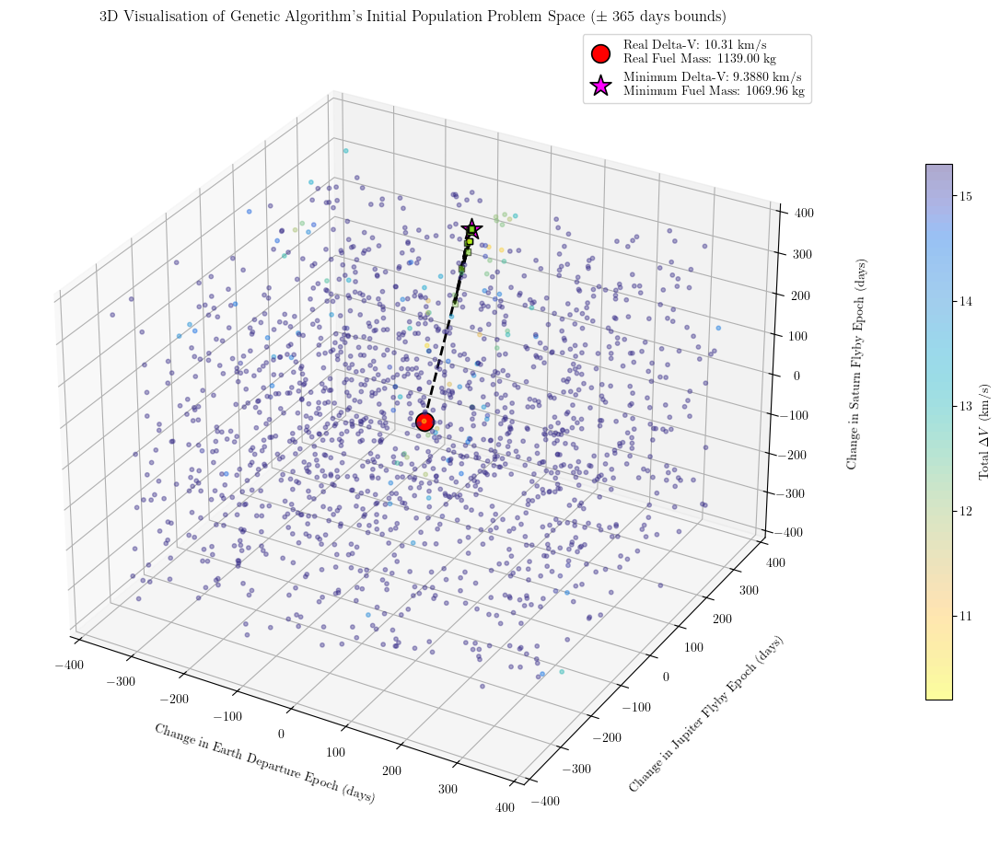

In [150]:
# Extract the population for the chosen generation
selected_population = population_per_generation[0]

# Extract dates and normalize relative to nominal mission dates
departure_dates_GA = np.array([ind[0] for ind in selected_population]) - date_departure_mjd
jupiter_flyby_dates_GA = np.array([ind[1] for ind in selected_population]) - date_flyby_jupiter_mjd
saturn_flyby_dates_GA = np.array([ind[2] for ind in selected_population]) - date_flyby_saturn_mjd

# Compute deltaV for coloring
deltaV_values_GA = np.array([find_deltaV_mission(*ind)[0] for ind in selected_population])

# Create 3D scatter plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(departure_dates_GA, jupiter_flyby_dates_GA, saturn_flyby_dates_GA,
                         c=deltaV_values_GA, cmap=parula_map(True), s=10, alpha=0.4,
                         norm=plt.Normalize(vmin=min(deltaV_values_GA), vmax=min(deltaV_values_GA) * 1.5))

ax.scatter(best_solutions_per_generation[:-6,0] - date_departure_mjd,
          best_solutions_per_generation[:-6,1] - date_flyby_jupiter_mjd,
          best_solutions_per_generation[:-6,2] - date_flyby_saturn_mjd,
          color='#81DB24', s=20, marker='s', edgecolors='black', linewidth=1 )

ax.scatter([0], 
           [0], 
           [0], 
           color='red', s=200, marker='o', edgecolors='black', linewidth=1.2, 
           label=f'Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg')

ax.scatter(date_departure_mjd_GA - date_departure_mjd, 
           date_flyby_jupiter_mjd_GA - date_flyby_jupiter_mjd, 
           date_flyby_saturn_mjd_GA - date_flyby_saturn_mjd, 
           color='fuchsia', s=300, marker='*', edgecolors='black', linewidth=1.2, 
           label=f'Minimum Delta-V: {deltaV_GA:.4f} km/s\nMinimum Fuel Mass: {fuel_mass_GA:.2f} kg')

ax.plot([0, departure_dates[0]], 
        [0, jupiter_flyby_dates[0]], 
        [0, saturn_flyby_dates[0]], 
        linestyle='--', color='black', markersize=6, linewidth=2, alpha=1)

ax.plot(departure_dates, jupiter_flyby_dates, saturn_flyby_dates, linestyle='--', color='black', markersize=6, linewidth=2, alpha=1)

# Set labels with increased padding
ax.set_xlabel('Change in Earth Departure Epoch (days)', labelpad=10)
ax.set_ylabel('Change in Jupiter Flyby Epoch (days)', labelpad=20)
ax.set_zlabel('Change in Saturn Flyby Epoch (days)', labelpad=20)

# Set title with increased padding
ax.set_title(f'3D Visualisation of Genetic Algorithm\'s Initial Population Problem Space ($\pm$ 365 days bounds)')

# Format the scientific notation to be more readable
for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
    formatter = ScalarFormatter(useOffset=False)
    formatter.set_scientific(True)
    formatter.set_powerlimits((-3, 3))  # Only use scientific notation for exponents outside this range
    axis.set_major_formatter(formatter)

# Position the offset text for better visibility
ax.xaxis.get_offset_text().set_position((0, -0.1))
ax.yaxis.get_offset_text().set_position((0, -0.1))
ax.zaxis.get_offset_text().set_position((0, -0.1))

# Ensure the exponent text is horizontally aligned
ax.xaxis.get_offset_text().set_ha('left')
ax.yaxis.get_offset_text().set_ha('left')
ax.zaxis.get_offset_text().set_ha('left')

# Add colorbar with adjusted position
cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, pad=0.1)
cbar.set_label('Total $\Delta V$ (km/s)')

ax.legend()
plt.tight_layout()
plt.savefig("voyager_I_GA_inital_pop_3D.png", dpi=500, bbox_inches="tight")

plt.show()

In [151]:
deltaV_values_for_each_gen = [find_deltaV_mission(*solution)[0] for solution in best_solutions_per_generation]
deltaV_values_for_each_gen

[10.199690250071933,
 10.199690250071933,
 9.7931819228846,
 9.53796651836861,
 9.486254042981379,
 9.474806659504512,
 9.433752116281681,
 9.399258049769639,
 9.399258049769639,
 9.399258049769639,
 9.395123174796796,
 9.395123174796796,
 9.394221706622059,
 9.390497008846175,
 9.390454024903446,
 9.390091239800709,
 9.390052415846453,
 9.38825802576161,
 9.38825802576161,
 9.38825802576161,
 9.38825802576161,
 9.38825802576161,
 9.38825802576161,
 9.38825802576161,
 9.38825802576161,
 9.388117564250676,
 9.388117564250676,
 9.388117564250676,
 9.388117564250676,
 9.388117564250676,
 9.388057584896789,
 9.388054974052567,
 9.388054974052567,
 9.388041002859524,
 9.388041002859524,
 9.388037951938298,
 9.388035180873903,
 9.388035180873903,
 9.388031400669009,
 9.388031400669009,
 9.388031400669009,
 9.388031400669009,
 9.38803044312096,
 9.38803044312096,
 9.38803044312096,
 9.38803044312096,
 9.38803044312096,
 9.38803044312096,
 9.38803034708787,
 9.388030090942555,
 9.3880300909425

In [152]:
# def plot_3d_ga_contour(population_per_generation, generation_idx):
#     if generation_idx >= len(population_per_generation) or generation_idx < 0:
#         print(f"Invalid generation index. Must be between 0 and {len(population_per_generation) - 1}.")
#         return
    
#     # Extract the population for the chosen generation
#     selected_population = population_per_generation[generation_idx]
    
#     # Extract dates and normalize relative to nominal mission dates
#     departure_dates_GA = np.array([ind[0] for ind in selected_population]) - date_departure_mjd
#     jupiter_flyby_dates_GA = np.array([ind[1] for ind in selected_population]) - date_flyby_jupiter_mjd
#     saturn_flyby_dates_GA = np.array([ind[2] for ind in selected_population]) - date_flyby_saturn_mjd
    
#     # Compute deltaV for coloring
#     deltaV_values_GA = np.array([find_deltaV_mission(*ind)[0] for ind in selected_population])
    
#     # Create 3D scatter plot
#     fig = plt.figure(figsize=(12, 10))
#     ax = fig.add_subplot(111, projection='3d')
    
#     scatter = ax.scatter(departure_dates_GA, jupiter_flyby_dates_GA, saturn_flyby_dates_GA,
#                              c=deltaV_values_GA, cmap=cmap, s=10, alpha=0.4,
#                              norm=plt.Normalize(vmin=min(deltaV_values_GA), vmax=min(deltaV_values_GA) * 1.5))

#     # Mark the best solution for the current generation
#     best_individual = selected_population[0]  # Best individual of the generation
#     ax.scatter(best_individual[0] - date_departure_mjd,
#                best_individual[1] - date_flyby_jupiter_mjd,
#                best_individual[2] - date_flyby_saturn_mjd,
#                color='red', s=100, marker='x', label="Best Solution")
    
#     # Set labels with increased padding
#     ax.set_xlabel('Change in Earth Departure Epoch (days)', labelpad=10)
#     ax.set_ylabel('Change in Jupiter Flyby Epoch (days)', labelpad=20)
#     ax.set_zlabel('Change in Saturn Flyby Epoch (days)', labelpad=20)
    
#     # Set title with increased padding
#     ax.set_title(f'3D Visualisation of GA Problem Space (Generation {generation_idx})', pad=20)
    
#     # Format the scientific notation to be more readable
#     for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
#         formatter = ScalarFormatter(useOffset=False)
#         formatter.set_scientific(True)
#         formatter.set_powerlimits((-3, 3))  # Only use scientific notation for exponents outside this range
#         axis.set_major_formatter(formatter)

#     # Position the offset text for better visibility
#     ax.xaxis.get_offset_text().set_position((0, -0.1))
#     ax.yaxis.get_offset_text().set_position((0, -0.1))
#     ax.zaxis.get_offset_text().set_position((0, -0.1))

#     # Ensure the exponent text is horizontally aligned
#     ax.xaxis.get_offset_text().set_ha('left')
#     ax.yaxis.get_offset_text().set_ha('left')
#     ax.zaxis.get_offset_text().set_ha('left')
    
#     # Add colorbar with adjusted position
#     cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, pad=0.1)
#     cbar.set_label('Total $\Delta V$ (km/s)')
    
#     # Adjust figure layout to make room for labels
#     plt.tight_layout()
    
#     plt.legend()
#     plt.show()

# # Example Usage: Pick a generation to visualize (e.g., 10th generation)
# plot_3d_ga_contour(population_per_generation, 0)

## GA Results --> Fmin

In [154]:
%%time 

# Start timing
start_time = time.time()

# Run optimization using `fmin` with manual bounds enforcement
optimal_dates = fmin(objective_function, GA_list, disp=True)

# Extract optimized dates
date_departure_mjd_GA_FMIN_COMBINED, date_flyby_jupiter_mjd_GA_FMIN_COMBINED, date_flyby_saturn_mjd_GA_FMIN_COMBINED = optimal_dates

# Compute Delta-V and fuel mass at optimized dates
deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED = find_deltaV_mission(date_departure_mjd_GA_FMIN_COMBINED, date_flyby_jupiter_mjd_GA_FMIN_COMBINED, date_flyby_saturn_mjd_GA_FMIN_COMBINED)

# Display results
print(f"Minimum Delta-V: {deltaV_GA_FMIN_COMBINED:.4f} km/s")
print(f"Optimal Departure Date (MJD): {date_departure_mjd_GA_FMIN_COMBINED:.2f}")
print(f"Optimal Jupiter Flyby Date (MJD): {date_flyby_jupiter_mjd_GA_FMIN_COMBINED:.2f}")
print(f"Optimal Saturn Flyby Date (MJD): {date_flyby_saturn_mjd_GA_FMIN_COMBINED:.2f}")

# Convert to calendar dates
print("\nIn calendar dates:")
print(f"Departure: {MJD_to_TT_calander_date(date_departure_mjd_GA_FMIN_COMBINED)}")
print(f"Jupiter flyby: {MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA_FMIN_COMBINED)}")
print(f"Saturn flyby: {MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA_FMIN_COMBINED)}")

# End timing
end_time = time.time()
execution_time_GA_FMIN_COMBINED = end_time - start_time
print(f"\nExecution Time: {execution_time_GA_FMIN_COMBINED:.4f} seconds")

Optimization terminated successfully.
         Current function value: 9.388030
         Iterations: 105
         Function evaluations: 196
Minimum Delta-V: 9.3880 km/s
Optimal Departure Date (MJD): 43388.37
Optimal Jupiter Flyby Date (MJD): 44099.45
Optimal Saturn Flyby Date (MJD): 44920.99

In calendar dates:
Departure: 1977-09-02 08:54:51.410
Jupiter flyby: 1979-08-14 10:52:57.650
Saturn flyby: 1981-11-12 23:46:00.000

Execution Time: 0.5098 seconds
CPU times: user 504 ms, sys: 9.49 ms, total: 514 ms
Wall time: 510 ms


In [155]:
deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED = find_deltaV_mission(date_departure_mjd_GA_FMIN_COMBINED, date_flyby_jupiter_mjd_GA_FMIN_COMBINED, date_flyby_saturn_mjd_GA_FMIN_COMBINED)
deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED

(9.388030090942555,
 1069.9564210491797,
 {'deltaV_injection (km/s)': 9.388030076492688,
  'deltaV_jupiter (km/s)': 1.4449867080656986e-08,
  'rp_jupiter (km)': 848168.1927761217,
  'tof (days)': 1532.6188494168453})

In [156]:
change_in_dates_list_FMIN_COMBINED = [
    (date_departure_mjd - date_departure_mjd_GA_FMIN_COMBINED),
    (date_flyby_jupiter_mjd - date_flyby_jupiter_mjd_GA_FMIN_COMBINED),
    (date_flyby_saturn_mjd - date_flyby_saturn_mjd_GA_FMIN_COMBINED)
]
change_in_dates_list_FMIN_COMBINED

[6.009127194643952, -161.94997280287498, -365.0]

In [157]:
print("Earth-Jupiter:",date_flyby_jupiter_mjd_GA_FMIN_COMBINED - date_departure_mjd_GA_FMIN_COMBINED,"days")
print("Jupiter-Saturn:",date_flyby_saturn_mjd_GA_FMIN_COMBINED - date_flyby_jupiter_mjd_GA_FMIN_COMBINED,"days")

Earth-Jupiter: 711.0820166638441 days
Jupiter-Saturn: 821.5368327530014 days


In [158]:
date_departure_GA_FMIN_COMBINED = MJD_to_TT_calander_date(date_departure_mjd_GA_FMIN_COMBINED)
date_flyby_jupiter_GA_FMIN_COMBINED = MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA_FMIN_COMBINED)
date_flyby_saturn_GA_FMIN_COMBINED = MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA_FMIN_COMBINED)

print("Date of Departure (Min):", MJD_to_TT_calander_date(date_departure_mjd_GA_FMIN_COMBINED))

print("Date of Jupiter Flyby (Min):", MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA_FMIN_COMBINED))

print("Date of Saturn Flyby (Min):", MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA_FMIN_COMBINED))

Date of Departure (Min): 1977-09-02 08:54:51.410
Date of Jupiter Flyby (Min): 1979-08-14 10:52:57.650
Date of Saturn Flyby (Min): 1981-11-12 23:46:00.000


# Graphs

## Comparsion Graphs

In [161]:
def plot_VoyagerI(date_departure, date_flyby_jupiter, date_flyby_saturn, colour, label_suffix=""):
    
    # Convert input dates to Astropy Time in TDB scale
    date_departure = Time(date_departure, scale="tt").tdb
    date_flyby_jupiter = Time(date_flyby_jupiter, scale="tt").tdb
    date_flyby_saturn = Time(date_flyby_saturn, scale="tt").tdb

    date_arrival = date_flyby_saturn

    # Define planetary ephemerides
    earth = Ephem.from_body(Earth, time_range(date_departure, end=date_arrival, periods=500))
    ss_earth = Orbit.from_ephem(Sun, earth, date_departure)

    jupiter = Ephem.from_body(Jupiter, time_range(date_departure, end=date_arrival, periods=500))
    ss_jupiter = Orbit.from_ephem(Sun, jupiter, date_flyby_jupiter)

    saturn = Ephem.from_body(Saturn, time_range(date_departure, end=date_arrival, periods=500))
    ss_saturn = Orbit.from_ephem(Sun, saturn, date_arrival)

    # Solving for maneuver to Jupiter
    man_flyby_jupiter = Maneuver.lambert(ss_earth, ss_jupiter)
    ic1 = ss_earth.apply_maneuver(man_flyby_jupiter)
    ic1_end = ic1.propagate(date_flyby_jupiter)

    # Solving for maneuver to Saturn
    man_flyby_saturn = Maneuver.lambert(ic1_end, ss_saturn)
    ic2 = ic1_end.apply_maneuver(man_flyby_saturn)
    ic2_end = ic2.propagate(date_arrival)

    # Plot Earth's position at departure
    plotter.plot_body_orbit(
        Earth, date_departure, label=f"Earth Departure {label_suffix}", trail=True
    )

    # Plot cruise to Jupiter
    plotter.plot_maneuver(
        ss_earth, man_flyby_jupiter, label=f"Cruise to Jupiter {label_suffix}", color=colour
    )

    # Plot Jupiter's position at flyby
    plotter.plot_body_orbit(
        Jupiter, date_flyby_jupiter, label=f"Jupiter Flyby {label_suffix}", trail=True
    )

    # Plot cruise to Saturn
    plotter.plot_maneuver(
        ic1_end, man_flyby_saturn, label=f"Cruise to Saturn {label_suffix}", color=colour
    )

    # Plot Earth's position at departure
    plotter.plot_body_orbit(
        Earth, date_departure, label=f"Earth Departure {label_suffix}", trail=True
    )

    # Plot Jupiter's position at flyby
    plotter.plot_body_orbit(
        Jupiter, date_flyby_jupiter, label=f"Jupiter Flyby {label_suffix}", trail=True
    )

    # Plot Saturn's position at arrival
    plotter.plot_body_orbit(
        Saturn, date_flyby_saturn, label=f"Saturn Arrival {label_suffix}", trail=True
    )

### 2-Axis

In [163]:
# plt.rc('text', usetex=True)
# plt.rc('font', family='serif')

# fig, ax = plt.subplots(figsize=(6, 14))  # Set square figure size
# plotter = StaticOrbitPlotter(ax)

# def plot_VoyagerI(date_departure, date_flyby_jupiter, date_flyby_saturn, colour, label_suffix=""):
    
#     # Convert input dates to Astropy Time in TDB scale
#     date_departure = Time(date_departure, scale="tt").tdb
#     date_flyby_jupiter = Time(date_flyby_jupiter, scale="tt").tdb
#     date_flyby_saturn = Time(date_flyby_saturn, scale="tt").tdb

#     date_arrival = date_flyby_saturn

#     # Define planetary ephemerides
#     earth = Ephem.from_body(Earth, time_range(date_departure, end=date_arrival, periods=500))
#     ss_earth = Orbit.from_ephem(Sun, earth, date_departure)

#     jupiter = Ephem.from_body(Jupiter, time_range(date_departure, end=date_arrival, periods=500))
#     ss_jupiter = Orbit.from_ephem(Sun, jupiter, date_flyby_jupiter)

#     saturn = Ephem.from_body(Saturn, time_range(date_departure, end=date_arrival, periods=500))
#     ss_saturn = Orbit.from_ephem(Sun, saturn, date_arrival)

#     # Solving for maneuver to Jupiter
#     man_flyby_jupiter = Maneuver.lambert(ss_earth, ss_jupiter)
#     ic1 = ss_earth.apply_maneuver(man_flyby_jupiter)
#     ic1_end = ic1.propagate(date_flyby_jupiter)

#     # Solving for maneuver to Saturn
#     man_flyby_saturn = Maneuver.lambert(ic1_end, ss_saturn)
#     ic2 = ic1_end.apply_maneuver(man_flyby_saturn)
#     ic2_end = ic2.propagate(date_arrival)

#     # Plot Earth's position at departure
#     plotter.plot_body_orbit(
#         Earth, date_departure, label=f"Earth Departure {label_suffix}", trail=True
#     )

#     # Plot cruise to Jupiter
#     plotter.plot_maneuver(
#         ss_earth, man_flyby_jupiter, label=f"Cruise to Jupiter {label_suffix}", color=colour
#     )

#     # Plot Jupiter's position at flyby
#     plotter.plot_body_orbit(
#         Jupiter, date_flyby_jupiter, label=f"Jupiter Flyby {label_suffix}", trail=True
#     )

#     # Plot cruise to Saturn
#     plotter.plot_maneuver(
#         ic1_end, man_flyby_saturn, label=f"Cruise to Saturn {label_suffix}", color=colour
#     )

#     # Plot Saturn's position at arrival
#     plotter.plot_body_orbit(
#         Saturn, date_flyby_saturn, label=f"Saturn Arrival {label_suffix}", trail=True
#     )

# # Plot both missions on the same graph
# plot_VoyagerI(date_departure, date_flyby_jupiter, date_flyby_saturn, "red", label_suffix="(Real Mission)")
# plot_VoyagerI(date_departure_BRUTE_MIN, date_flyby_jupiter_BRUTE_MIN, date_flyby_saturn_BRUTE_MIN, "cyan", label_suffix="(Brute Force Algorithm)")
# plot_VoyagerI(date_departure_FMIN, date_flyby_jupiter_FMIN, date_flyby_saturn_FMIN, "#00ff00", label_suffix="(FMIN)")
# plot_VoyagerI(GA_list_calendar[0], GA_list_calendar[1], GA_list_calendar[2], "magenta", label_suffix="(GA)")

# plt.title("Voyager I Mission")

# # Set consistent limits for the main axis
# ax.set_xlim(-1.6e9, 1.6e9)
# ax.set_ylim(-1.6e9, 1.6e9)  # Equal extent in both directions for square aspect

# # Conversion factor (1 AU = 149,597,870.691 km)
# km_to_AU = 1 / 149597870.691

# # Create secondary x-axis (Distance in AU)
# ax2 = ax.twiny()
# ax2.set_xlabel("x (AU)")
# ax2.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)

# # Create secondary y-axis (Distance in AU)
# ax3 = ax.twinx()
# ax3.set_ylabel("y (AU)")
# ax3.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)

# # Improve grid and ticks
# ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
# ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
# ax.minorticks_on()

# # Customize tick parameters
# ax.tick_params(axis='both', which='major', labelsize=12)
# ax.tick_params(axis='both', which='minor', labelsize=10)

# # Set equal aspect ratio for the main axis only
# ax.set_aspect('auto')

# # Define different line styles for each plot
# line_styles = {
#     "(Real Mission)": "-",
#     "(Brute Force Algorithm)": "--",
#     "(FMIN)": "-.",
#     "(GA)": "--"
# }
# # Define different line widths for clarity
# line_widths = {
#     "(Real Mission)": 1,
#     "(Brute Force Algorithm)": 2.5,
#     "(FMIN)": 1.5,
#     "(GA)": 1
# }
# # Reduce line width for maneuver trajectories and apply different styles
# for line in ax.get_lines():
#     label = line.get_label()
#     for key in line_styles:
#         if key in label:
#             line.set_linestyle(line_styles[key])
#             line.set_linewidth(line_widths[key])

# # Remove any existing legends (if any)
# if ax.get_legend() is not None:
#     ax.get_legend().remove()

# # Create custom legend handles with matching line colours
# handles = [
#     Line2D([0], [0], color='red', lw=2, label="Real Mission"),
#     Line2D([0], [0], color='cyan', lw=2, label="Brute Force Algorithm"),
#     Line2D([0], [0], color='#00ff00', lw=2, label="FMIN"),
#     Line2D([0], [0], color='magenta', lw=2, label="GA")
# ]

# # Add the custom legend with 4 rows
# plt.legend(handles=handles, loc="upper left", ncol=4)

# plt.tight_layout()
# plt.savefig("voyager_I_trajectory.png", dpi=500, bbox_inches="tight")

# # Show plot
# plt.show()

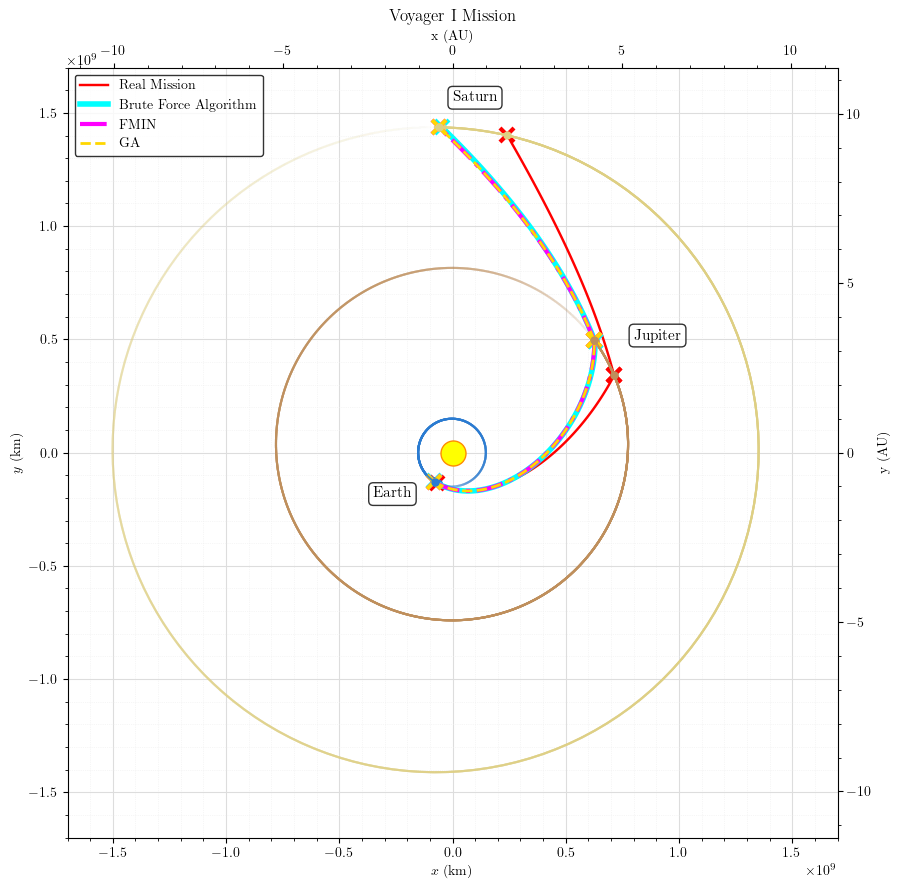

In [164]:
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Create figure and axis
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111)
plotter = StaticOrbitPlotter(ax)

# Define different line styles for each plot
colours = {
    "Real Mission": "red",
    "Brute Force Algorithm": "cyan",
    "FMIN": "magenta",
    "GA": "gold",
    "GA --> FMIN": "lime"
}

# Plot missions
plot_VoyagerI(date_departure, date_flyby_jupiter, date_flyby_saturn, colours["Real Mission"], label_suffix="(Real Mission)")
plot_VoyagerI(date_departure_BRUTE_MIN, date_flyby_jupiter_BRUTE_MIN, date_flyby_saturn_BRUTE_MIN, colours["Brute Force Algorithm"], label_suffix="(Brute Force Algorithm)")
plot_VoyagerI(date_departure_FMIN, date_flyby_jupiter_FMIN, date_flyby_saturn_FMIN, colours["FMIN"], label_suffix="(FMIN)")
plot_VoyagerI(date_departure_GA, date_flyby_jupiter_GA, date_flyby_saturn_GA, colours["GA"], label_suffix="(GA)")
#plot_VoyagerI(date_departure_GA_FMIN_COMBINED, date_flyby_jupiter_GA_FMIN_COMBINED, date_flyby_saturn_GA_FMIN_COMBINED, colours["GA --> FMIN"], label_suffix="(GA --> FMIN)")

# Set fixed limits for primary axis
limit = 1.7e9
ax.set_xlim(-limit, limit)
ax.set_ylim(-limit, limit)
ax.set_aspect('equal')  # Square aspect ratio

# Conversion factor (1 AU = 149,597,870.691 km)
km_to_AU = 1 / 149597870.691

# Create second set of axes for AU scale
# These won't be linked to the primary axes in the problematic way
ax_top = fig.add_axes(ax.get_position(), frameon=False)
ax_top.xaxis.tick_top()
ax_top.yaxis.tick_right()
ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
ax_top.set_xlabel("x (AU)")#, labelpad=10)
ax_top.set_ylabel("y (AU)")#, labelpad=10)
ax_top.xaxis.set_label_position('top')
ax_top.yaxis.set_label_position('right')

# Add grid
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax.minorticks_on()
#ax_top.grid(which='major', color='#DDDDDD', linewidth=0.8)
#ax_top.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax_top.minorticks_on()

# Customize tick parameters
ax.tick_params(axis='both', which='major', labelsize=10)
ax.tick_params(axis='both', which='minor', labelsize=8)
ax_top.tick_params(axis='both', which='major', labelsize=10)
ax_top.tick_params(axis='both', which='minor', labelsize=8)

# Add title
plt.title("Voyager I Mission")

# Function to update AU axes when primary axes change
def update_au_axes(event=None):
    ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
    ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
    fig.canvas.draw_idle()

# Connect the update function to the 'xlim_changed' and 'ylim_changed' events
ax.callbacks.connect('xlim_changed', update_au_axes)
ax.callbacks.connect('ylim_changed', update_au_axes)

# Define different line styles for each plot
line_styles = {
    "Real Mission": "-",
    "Brute Force Algorithm": "-",
    "FMIN": "-.",
    "GA": "--",
    "GA --> FMIN": ":"
}
# Define different line widths for clarity
line_widths = {
    "Real Mission": 1.75,
    "Brute Force Algorithm": 4,
    "FMIN": 3,
    "GA": 2,
    "GA --> FMIN": 2
}

# Apply line styles
for line in ax.get_lines():
    label = line.get_label()
    for key in line_styles:
        if key in label:
            line.set_linestyle(line_styles[key])
            line.set_linewidth(line_widths[key])

# Create custom legend
handles = [
    Line2D([0], [0], color=colours['Real Mission'], ls=line_styles['Real Mission'], lw=line_widths['Real Mission'], label="Real Mission"),
    Line2D([0], [0], color=colours['Brute Force Algorithm'], ls=line_styles['Brute Force Algorithm'], lw=line_widths['Brute Force Algorithm'], label="Brute Force Algorithm"),
    Line2D([0], [0], color=colours['FMIN'], ls=line_styles['FMIN'], lw=line_widths['FMIN'], label="FMIN"),
    Line2D([0], [0], color=colours['GA'], ls=line_styles['GA'], lw=line_widths['GA'], label="GA"),
    #Line2D([0], [0], color=colours['GA --> FMIN'], ls=line_styles['GA --> FMIN'], lw=line_widths['GA --> FMIN'], label="GA \& FMIN")
]

ax.plot(0, 0, 'o', markersize=18, markerfacecolor='#FFFF00', markeredgecolor='#FF8C00', markeredgewidth=1, zorder=100)

# Add legend
ax.legend(handles=handles, loc="upper left", ncol=1, frameon=True, edgecolor='black')

# Planet colors
planet_colors = {
    "Earth": "#3366FF",    # Blue
    "Jupiter": "#FF9933",  # Orange
    "Saturn": "#FFCC33"    # Yellow
}

# Use the new label positions provided
planet_label_positions = {
    "Earth": (-0.35e9, -0.2e9),
    "Jupiter": (0.8e9, 0.5e9),
    "Saturn": (0e9, 1.55e9)
}

# Add each planet marker and label
for planet, position in planet_label_positions.items():
    x, y = position
    
    # Use the absolute positions for labels instead of offsets
    label_x, label_y = planet_label_positions[planet]
    
    bbox_props = dict(boxstyle="round,pad=0.3", fc="white", ec="black", alpha=0.8)
    ax.annotate(planet, 
               xy=(x, y),  # Position of the planet
               xytext=(label_x, label_y),  # Absolute position for the label
               textcoords='data',  # Changed from 'offset points' to 'data'
               bbox=bbox_props,
               fontsize=11,
               fontweight='bold',
               zorder=101,  # Ensure labels appear on top of everything
               )  # Add arrow connecting label to planet

# Save figure with padding
plt.savefig("voyager_I_trajectory_km_AU.png", dpi=500, bbox_inches="tight")

# Show plot
plt.show()

In [165]:
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

In [166]:
matrix = np.array([
    [1,2,3],
    [4,5,6],
    [7,8,9]
])

matrix[0,2]

3

### 2-Axis Zoomed

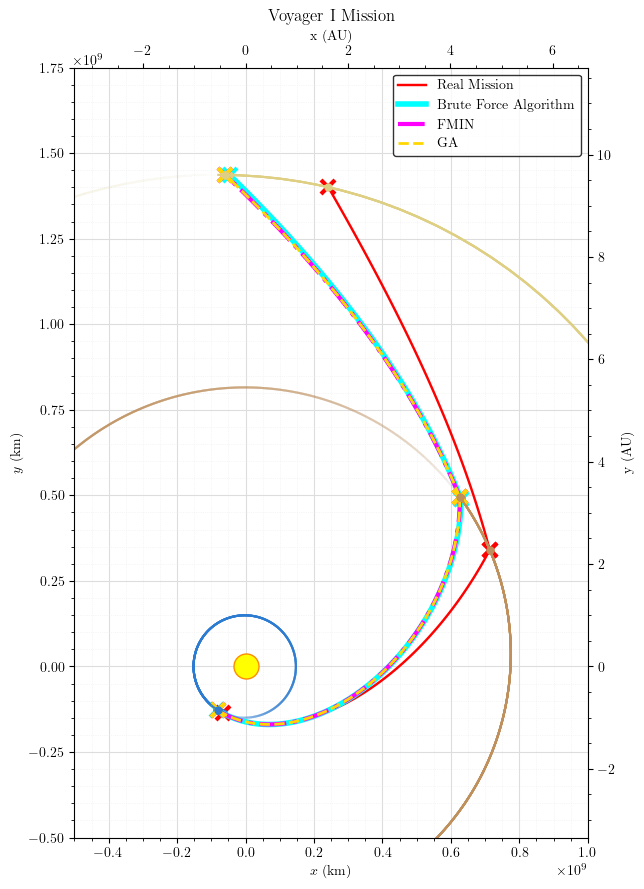

In [168]:
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Create figure and axis
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111)
plotter = StaticOrbitPlotter(ax)

# Plot missions
plot_VoyagerI(date_departure, date_flyby_jupiter, date_flyby_saturn, colours["Real Mission"], label_suffix="(Real Mission)")
plot_VoyagerI(date_departure_BRUTE_MIN, date_flyby_jupiter_BRUTE_MIN, date_flyby_saturn_BRUTE_MIN, colours["Brute Force Algorithm"], label_suffix="(Brute Force Algorithm)")
plot_VoyagerI(date_departure_FMIN, date_flyby_jupiter_FMIN, date_flyby_saturn_FMIN, colours["FMIN"], label_suffix="(FMIN)")
plot_VoyagerI(date_departure_GA, date_flyby_jupiter_GA, date_flyby_saturn_GA, colours["GA"], label_suffix="(GA)")
#plot_VoyagerI(date_departure_GA_FMIN_COMBINED, date_flyby_jupiter_GA_FMIN_COMBINED, date_flyby_saturn_GA_FMIN_COMBINED, colours["GA --> FMIN"], label_suffix="(GA --> FMIN)")

# Set fixed limits for primary axis
ax.set_xlim(-.5e9, 1e9)
ax.set_ylim(-.5e9, 1.75e9)
ax.set_aspect('equal')  # Square aspect ratio

# Conversion factor (1 AU = 149,597,870.691 km)
km_to_AU = 1 / 149597870.691

# Create second set of axes for AU scale
# These won't be linked to the primary axes in the problematic way
ax_top = fig.add_axes(ax.get_position(), frameon=False)
ax_top.xaxis.tick_top()
ax_top.yaxis.tick_right()
ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
ax_top.set_xlabel("x (AU)")#, labelpad=10)
ax_top.set_ylabel("y (AU)")#, labelpad=10)
ax_top.xaxis.set_label_position('top')
ax_top.yaxis.set_label_position('right')

# Add grid
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax.minorticks_on()
#ax_top.grid(which='major', color='#DDDDDD', linewidth=0.8)
#ax_top.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax_top.minorticks_on()

# Customize tick parameters
ax.tick_params(axis='both', which='major', labelsize=10)
ax.tick_params(axis='both', which='minor', labelsize=8)
ax_top.tick_params(axis='both', which='major', labelsize=10)
ax_top.tick_params(axis='both', which='minor', labelsize=8)

# Add title
plt.title("Voyager I Mission")

# Function to update AU axes when primary axes change
def update_au_axes(event=None):
    ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
    ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
    fig.canvas.draw_idle()

# Connect the update function to the 'xlim_changed' and 'ylim_changed' events
ax.callbacks.connect('xlim_changed', update_au_axes)
ax.callbacks.connect('ylim_changed', update_au_axes)

# Apply line styles
for line in ax.get_lines():
    label = line.get_label()
    for key in line_styles:
        if key in label:
            line.set_linestyle(line_styles[key])
            line.set_linewidth(line_widths[key])

# Create custom legend
handles = [
    Line2D([0], [0], color=colours['Real Mission'], ls=line_styles['Real Mission'], lw=line_widths['Real Mission'], label="Real Mission"),
    Line2D([0], [0], color=colours['Brute Force Algorithm'], ls=line_styles['Brute Force Algorithm'], lw=line_widths['Brute Force Algorithm'], label="Brute Force Algorithm"),
    Line2D([0], [0], color=colours['FMIN'], ls=line_styles['FMIN'], lw=line_widths['FMIN'], label="FMIN"),
    Line2D([0], [0], color=colours['GA'], ls=line_styles['GA'], lw=line_widths['GA'], label="GA"),
    #Line2D([0], [0], color=colours['GA --> FMIN'], ls=line_styles['GA --> FMIN'], lw=line_widths['GA --> FMIN'], label="GA \& FMIN")
]

ax.plot(0, 0, 'o', markersize=18, markerfacecolor='#FFFF00', markeredgecolor='#FF8C00', markeredgewidth=1, zorder=100)

# Add legend
ax.legend(handles=handles, loc="best", ncol=1, frameon=True, edgecolor='black')

#plt.tight_layout()
plt.savefig("voyager_I_trajectory_zoom.png", dpi=500, bbox_inches="tight")

# Show plot
plt.show()

## Genetic Algorithm (GA) Animation

### Orbital Trajectory per Generation

In [171]:
# Ensure real mission is first in the best solutions list
best_solutions_per_generation,len(best_solutions_per_generation)

(array([[43399.63999698, 44072.61624804, 44910.76940777],
        [43399.63999698, 44072.61624804, 44910.76940777],
        [43384.26298259, 44054.17405524, 44766.35829205],
        [43383.13528741, 44101.3014299 , 44915.4948804 ],
        [43388.78512713, 44086.59163063, 44873.29625324],
        [43387.13122054, 44068.49978135, 44843.78249351],
        [43387.80250393, 44086.58396811, 44893.76067183],
        [43387.12775218, 44099.94750289, 44920.89994479],
        [43387.12775218, 44099.94750289, 44920.89994479],
        [43387.12775218, 44099.94750289, 44920.89994479],
        [43387.6661139 , 44096.60904861, 44914.14111908],
        [43387.6661139 , 44096.60904861, 44914.14111908],
        [43387.68455851, 44099.92037143, 44920.99027778],
        [43387.93923726, 44099.62669904, 44920.99027778],
        [43388.33903064, 44098.37516132, 44918.40880138],
        [43387.70675212, 44099.29357733, 44920.79947289],
        [43387.92781242, 44099.56828768, 44920.99027778],
        [43388

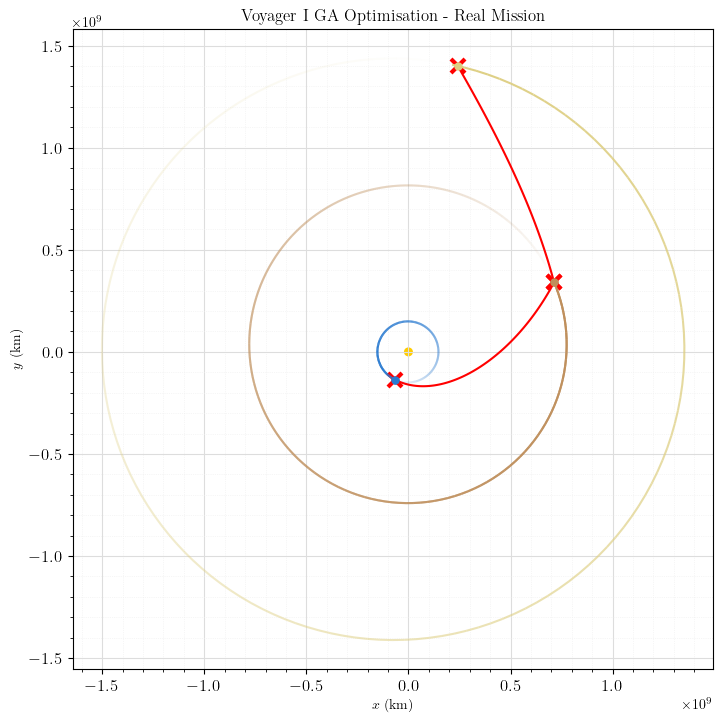

In [172]:
fig, ax = plt.subplots(figsize=(9, 7))
plotter = StaticOrbitPlotter(ax)

# Store previously plotted trajectories
plotted_trajectories = []

# Select a colour map (viridis, plasma, coolwarm, rainbow, etc.)
cmap = plt.cm.rainbow  # Change this for different color gradients

# Flag to track if we've plotted the real mission trajectory
real_mission_plotted = False

# Function to update the plot at each generation
def update(frame):
    global real_mission_plotted
    
    # Plot the real mission trajectory only once at the first frame
    if frame == 0:
        # Plot real mission in red
        real_traj = plot_VoyagerI(date_departure, date_flyby_jupiter, date_flyby_saturn, 
                                 "red", label_suffix="(Real Mission)")
        plotted_trajectories.append(real_traj)
        real_mission_plotted = True
    else:
        # Get best trajectory for this generation
        best_traj = best_solutions_per_generation[frame-1]
        date_departure_gen, date_flyby_jupiter_gen, date_flyby_saturn_gen = best_traj
        
        # Convert MJD to calendar date
        date_departure_gen = MJD_to_TT_calander_date(date_departure_gen)
        date_flyby_jupiter_gen = MJD_to_TT_calander_date(date_flyby_jupiter_gen)
        date_flyby_saturn_gen = MJD_to_TT_calander_date(date_flyby_saturn_gen)
        
        # Normalize color based on generation number
        norm_color = cmap(frame / len(best_solutions_per_generation))
        
        # Plot new trajectory with gradient color
        traj_plot = plot_VoyagerI(date_departure_gen, date_flyby_jupiter_gen, 
                                 date_flyby_saturn_gen, norm_color, 
                                 label_suffix=f"(Gen {frame-1})")
        
        # Store the trajectory plot for reference
        plotted_trajectories.append(traj_plot)
    
    # Hide the legend during animation to prevent clutter
    ax.legend().set_visible(False)

    if frame == 0:
        ax.set_title(f"Voyager I GA Optimisation - Real Mission")
    else:
        # Set title dynamically
        ax.set_title(f"Voyager I GA Optimisation - Generation {frame-1}")
    
    return plotted_trajectories

# Improve grid and ticks
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax.minorticks_on()

# Customize tick parameters
ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=10)

plt.tight_layout()

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(best_solutions_per_generation)+1, 
                              repeat=False, blit=False)

# Save the animation as a GIF or MP4
#ani.save("voyager_I_GA_optimisation.mp4", writer="ffmpeg", fps=5)#, dpi=200, bitrate=-1)
#ani.save("voyager_I_GA_optimisation.gif", writer="pillow", fps=10, dpi=200)  # Save as GIF

In [173]:
# Convert animation to HTML
html_video = ani.to_jshtml()

# Display animation inline
display(HTML(html_video))

### GA Problem Space per Generation

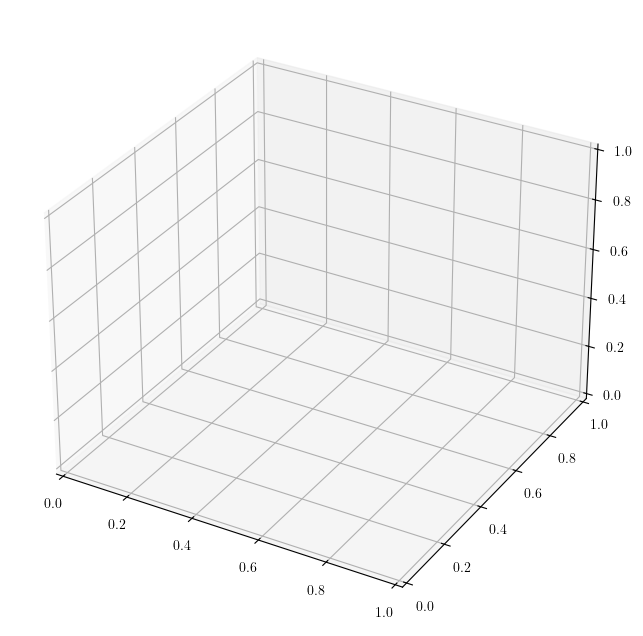

In [175]:
# Function to animate the evolution of the genetic algorithm
def animate_3d_ga_contour(population_per_generation):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    cmap = plt.cm.viridis_r  # Color map for deltaV values
    cbar = None  # Initialize colorbar variable

    def update(frame):
        nonlocal cbar
        ax.clear()
        generation_idx = frame
        selected_population = population_per_generation[generation_idx]

        # Extract dates and normalize relative to nominal mission dates
        departure_dates_GA = np.array([ind[0] for ind in selected_population]) - date_departure_mjd
        jupiter_flyby_dates_GA = np.array([ind[1] for ind in selected_population]) - date_flyby_jupiter_mjd
        saturn_flyby_dates_GA = np.array([ind[2] for ind in selected_population]) - date_flyby_saturn_mjd
        
        # Compute deltaV for coloring
        deltaV_values_GA = np.array([find_deltaV_mission(*ind)[0] for ind in selected_population])
        
        scatter = ax.scatter(departure_dates_GA, jupiter_flyby_dates_GA, saturn_flyby_dates_GA,
                             c=deltaV_values_GA, cmap=parula_map(True), s=10, alpha=0.3,
                             norm=plt.Normalize(vmin=min(deltaV_values_GA), vmax=min(deltaV_values_GA) * 1.5))

        # Mark the best solution for the current generation
        best_individual = selected_population[0]  # Best individual of the generation
        ax.scatter(best_individual[0] - date_departure_mjd,
                   best_individual[1] - date_flyby_jupiter_mjd,
                   best_individual[2] - date_flyby_saturn_mjd,
                   color='red', s=100, marker='x', label="Best Solution")

        ax.scatter([0],
                   [0],
                   [0],
                   color='red', s=100, marker='o', edgecolors='black', linewidth=1.2,
                   label=f'Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg')

        # Set labels with increased padding
        ax.set_xlabel('Change in Earth Departure Epoch (days)', labelpad=10)
        ax.set_ylabel('Change in Jupiter Flyby Epoch (days)', labelpad=20)
        ax.set_zlabel('Change in Saturn Flyby Epoch (days)', labelpad=20)
        
        # Set title with increased padding
        ax.set_title(f'3D Visualisation of GA Problem Space (Generation {generation_idx})', pad=20)
        
        # Format the scientific notation to be more readable
        for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
            formatter = ScalarFormatter(useOffset=False)
            formatter.set_scientific(True)
            formatter.set_powerlimits((-3, 3))  # Only use scientific notation for exponents outside this range
            axis.set_major_formatter(formatter)
    
        # Position the offset text for better visibility
        ax.xaxis.get_offset_text().set_position((0, -0.1))
        ax.yaxis.get_offset_text().set_position((0, -0.1))
        ax.zaxis.get_offset_text().set_position((0, -0.1))
    
        # Ensure the exponent text is horizontally aligned
        ax.xaxis.get_offset_text().set_ha('left')
        ax.yaxis.get_offset_text().set_ha('left')
        ax.zaxis.get_offset_text().set_ha('left')

        ax.legend()

        limit = 365
        ax.set_xlim(-limit, limit)
        ax.set_ylim(-limit, limit)
        ax.set_zlim(-limit, limit)
        
        # Add colorbar only once
        if cbar is None:
            cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, pad=0.1)
            cbar.set_label('Total $\Delta V$ (km/s)')
    
    ani = animation.FuncAnimation(fig, update, frames=len(population_per_generation), repeat=False)
    plt.show()
    return ani

# Example Usage
ani = animate_3d_ga_contour(population_per_generation)

In [176]:
# Convert animation to HTML
html_video = ani.to_jshtml()

# Display animation inline
display(HTML(html_video))

## Final DeltaV \& Fuel Mass

In [178]:
deltaV_REAL, fuel_mass_REAL, data_dict_REAL

(10.31241583834745,
 1139.0,
 {'deltaV_injection (km/s)': 10.303632164583048,
  'deltaV_jupiter (km/s)': 0.008783673764401811,
  'rp_jupiter (km)': 339964.07869084046,
  'tof (days)': 1161.6097222222015})

In [179]:
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN

(9.411191461145675,
 1071.7476431066705,
 {'deltaV_injection (km/s)': 9.40484890472681,
  'deltaV_jupiter (km/s)': 0.006342556418864831,
  'rp_jupiter (km)': 820160.096156483,
  'tof (days)': 1519.1607426303601})

In [180]:
deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN

(9.388030073904538,
 1069.9564197303307,
 {'deltaV_injection (km/s)': 9.388030073866002,
  'deltaV_jupiter (km/s)': 3.8536285273949034e-11,
  'rp_jupiter (km)': 848168.1721327668,
  'tof (days)': 1532.6188724847307})

In [181]:
deltaV_GA, fuel_mass_GA, data_dict_GA

(9.388030090942555,
 1069.9564210491797,
 {'deltaV_injection (km/s)': 9.388030076492688,
  'deltaV_jupiter (km/s)': 1.4449867080656986e-08,
  'rp_jupiter (km)': 848168.1927761217,
  'tof (days)': 1532.6188494168453})

In [182]:
deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED

(9.388030090942555,
 1069.9564210491797,
 {'deltaV_injection (km/s)': 9.388030076492688,
  'deltaV_jupiter (km/s)': 1.4449867080656986e-08,
  'rp_jupiter (km)': 848168.1927761217,
  'tof (days)': 1532.6188494168453})

In [183]:
deltaVs = {
    "REAL": deltaV_REAL,
    "Brute Force": deltaV_BRUTE_MIN,
    "Fmin": deltaV_FMIN,
    "Genetic Algorithm": deltaV_GA,
    "Combined (Genetic Algorithm + Fmin)": deltaV_GA_FMIN_COMBINED
}

for method in deltaVs:
    print(f"{method}: {deltaVs[method]:.4f} km/s")

REAL: 10.3124 km/s
Brute Force: 9.4112 km/s
Fmin: 9.3880 km/s
Genetic Algorithm: 9.3880 km/s
Combined (Genetic Algorithm + Fmin): 9.3880 km/s


In [184]:
fuel_mass_values = {
    "REAL": fuel_mass_REAL,
    "Brute Force": fuel_mass_BRUTE_MIN,
    "Fmin": fuel_mass_FMIN,
    "Genetic Algorithm": fuel_mass_GA,
    "Combined (Genetic Algorithm + Fmin)": fuel_mass_GA_FMIN_COMBINED
}

for method in fuel_mass_values:
    print(f"{method}: {fuel_mass_values[method]:.2f} kg")

REAL: 1139.00 kg
Brute Force: 1071.75 kg
Fmin: 1069.96 kg
Genetic Algorithm: 1069.96 kg
Combined (Genetic Algorithm + Fmin): 1069.96 kg


In [185]:
execution_time_dict = {
    "Brute Force": execution_time_BRUTE_FORCE,
    "Fmin": execution_time_FMIN,
    "Genetic Algorithm": execution_time_GA,
    "Combined (Genetic Algorithm + Fmin)": execution_time_GA_FMIN_COMBINED
}

for method, time in execution_time_dict.items():
    print(f"{method}: {time:.2f} seconds")

Brute Force: 476.04 seconds
Fmin: 1.07 seconds
Genetic Algorithm: 514.46 seconds
Combined (Genetic Algorithm + Fmin): 0.51 seconds


### Comparsion Table

In [187]:
# Data
methods = ["REAL", "Brute Force", "Genetic Algorithm", "Fmin", "Combined (Genetic Algorithm + Fmin)"]

data = {
    "Method": methods,
    "deltaV (km/s)": [deltaVs[method] for method in methods],
    "Fuel Mass (kg)": [fuel_mass_values[method] for method in methods],
    "Execution Time (s)": [execution_time_dict.get(method, None) for method in methods],
    "Departure Change (days)": [0, change_in_dates_list_BRUTE_MIN[0], change_in_dates_list_FMIN[0], change_in_dates_list_GA[0], change_in_dates_list_FMIN_COMBINED[0]],
    "Jupiter Flyby Change (days)": [0, change_in_dates_list_BRUTE_MIN[1], change_in_dates_list_FMIN[1], change_in_dates_list_GA[1], change_in_dates_list_FMIN_COMBINED[1]],
    "Saturn Flyby Change (days)": [0, change_in_dates_list_BRUTE_MIN[2], change_in_dates_list_FMIN[2], change_in_dates_list_GA[2], change_in_dates_list_FMIN_COMBINED[2]]
}

df = pd.DataFrame(data)
df

,Method,deltaV (km/s),Fuel Mass (kg),Execution Time (s),Departure Change (days),Jupiter Flyby Change (days),Saturn Flyby Change (days)
0,REAL,10.312416,1139.000000,NaN,0.000000,0.000000,0.000000
1,Brute Force,9.411191,1071.747643,476.038668,7.448980,-156.428571,-350.102041
2,Genetic Algorithm,9.388030,1069.956421,514.460473,6.009150,-161.949972,-365.000000
3,Fmin,9.388030,1069.956420,1.065906,6.009127,-161.949973,-365.000000
4,Combined (Genetic Algorithm + Fmin),9.388030,1069.956421,0.509752,6.009127,-161.949973,-365.000000


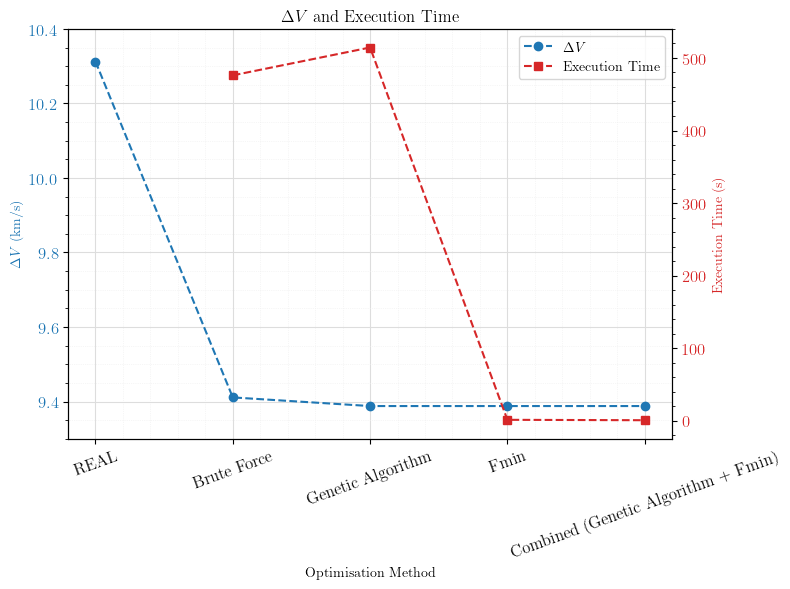

In [188]:
# Apply LaTeX styling
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

deltaV_values_method = [deltaVs[name] for name in methods]
execution_methods = [m for m in methods if m in execution_time_dict]
execution_times = [execution_time_dict[name] for name in execution_methods]

# Convert to numpy arrays for plotting
deltaV_values_method = np.array(deltaV_values_method, dtype=float)
execution_times = np.array(execution_times, dtype=float)

fig, ax1 = plt.subplots(figsize=(8, 6))

# Plot delta-V
ax1.set_xlabel("Optimisation Method")
ax1.set_ylabel("$\Delta V$ (km/s)", color='tab:blue')
ax1.plot(methods, deltaV_values_method, marker='o', linestyle='--', color='tab:blue', label="$\Delta V$")
ax1.tick_params(axis='y', labelcolor='tab:blue')
ax1.set_xticks(range(len(methods)))
ax1.set_xticklabels(methods, ha='center', rotation=20, fontsize=12)

# Secondary axis for execution time
ax2 = ax1.twinx()
ax2.set_ylabel("Execution Time (s)", color='tab:red')
ax2.plot(execution_methods, execution_times, marker='s', linestyle='--', color='tab:red', label="Execution Time")
ax2.tick_params(axis='y', labelcolor='tab:red')

# Add legends
ax1.legend(loc='upper right', handles=ax1.lines + ax2.lines, labels=["$\Delta V$", "Execution Time"])

# Improve grid and ticks
ax1.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax1.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)

ax1.minorticks_on()
ax2.minorticks_on()
ax1.tick_params(axis='both', which='major', labelsize=12)
ax2.tick_params(axis='both', which='major', labelsize=12)

ax1.tick_params(axis='x', which='minor', length=0)

ax1.set_ylim(9.3,10.4)
#ax2.set_ylim(0,500)

# Show title
plt.title("$\Delta V$ and Execution Time")
plt.tight_layout()
plt.show()

In [189]:
#math.factorial(20)

In [190]:
# # Extract data for all three dates
# # departure_mjd = [dates_list[num][0] for num in range(len(dates_list))]
# # jupiter_flyby_mjd = [dates_list[num][1] for num in range(len(dates_list))]
# # saturn_flyby_mjd = [dates_list[num][2] for num in range(len(dates_list))]
# # deltaV_values = [dates_list[num][3][0] for num in range(len(dates_list))]

# # Filter out any extreme values
# max_deltav_threshold = 12  # km/s (adjust as needed)
# valid_indices = [i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold]

# # Extract valid data
# valid_departure_mjd = [departure_mjd[i] for i in valid_indices]
# valid_jupiter_mjd = [jupiter_flyby_mjd[i] for i in valid_indices]
# valid_saturn_mjd = [saturn_flyby_mjd[i] for i in valid_indices]
# valid_deltaV = [deltaV_values[i] for i in valid_indices]

# # Create a 3D plot
# fig = plt.figure(figsize=(10, 8))
# ax = fig.add_subplot(111, projection='3d')

# # Create scatter plot with color based on delta-V
# scatter = ax.scatter(valid_departure_mjd, valid_jupiter_mjd, valid_saturn_mjd, 
#                      c=valid_deltaV, cmap=parula_map(True), s=10, alpha=0.7,
#                      norm=colors.Normalize(vmin=min(valid_deltaV), vmax=min(valid_deltaV) * 1.5))

# # Highlight different optimization results in the 3D plot
# ax.scatter([date_departure_mjd], [date_flyby_jupiter_mjd], [date_flyby_saturn_mjd], 
#            color='magenta', s=100, marker='*', 
#            label=f'Real Mission ($\Delta$V: {deltaV_REAL:.4f} km/s)')

# ax.scatter([date_departure_mjd_BRUTE_MIN], [date_flyby_jupiter_mjd_BRUTE_MIN], [date_flyby_saturn_mjd_BRUTE_MIN], 
#            color='red', s=100, marker='o', 
#            label=f'Brute Force ($\Delta$V: {deltaV_BRUTE_MIN:.4f} km/s)')

# ax.scatter([date_departure_mjd_FMIN], [date_flyby_jupiter_mjd_FMIN], [date_flyby_saturn_mjd_FMIN], 
#            color='blue', s=100, marker='s', 
#            label=f'FMIN ($\Delta$V: {deltaV_FMIN:.4f} km/s)')

# ax.scatter([date_departure_mjd_GA], [date_flyby_jupiter_mjd_GA], [date_flyby_saturn_mjd_GA], 
#            color='cyan', s=100, marker='D',
#            label=f'Genetic Algorithm ($\Delta$V: {deltaV_GA:.4f} km/s)')

# ax.scatter([date_departure_mjd_GA_FMIN_COMBINED], [date_flyby_jupiter_mjd_GA_FMIN_COMBINED], [date_flyby_saturn_mjd_GA_FMIN_COMBINED], 
#            color='lime', s=100, marker='H',
#            label=f'Genetic Algorithm + FMIN ($\Delta$V: {deltaV_GA_FMIN_COMBINED:.4f} km/s)')

# # Add colorbar
# cbar = plt.colorbar(scatter, ax=ax, label='Delta-V (km/s)')

# # Set labels and title
# ax.set_xlabel('Earth Departure Date (MJD)')
# ax.set_ylabel('Jupiter Flyby Date (MJD)')
# ax.set_zlabel('Saturn Flyby Date (MJD)')
# ax.set_title('3D Visualisation of Problem Space')

# # Add a legend
# ax.legend(loc = "upper right")
# #ax.view_init(elev=30, azim=135)  # Adjust elev (elevation) and azim (azimuth) as needed


# # Show both plots
# plt.tight_layout()
# #plt.savefig("voyager_I_brute_force_contour_3D.png", dpi=500, bbox_inches="tight")

# plt.show()

## Variation in Heliocentric Velocity along Voyager I Trajectory

In [192]:
# Known parameters K = [e,a,i,Omega,w,M]
mu = 1.327e11  # Sun's gravitational parameter (km³/s²)

# Compute true anomaly (theta) for 0<e<1 (elliptical orbit)
def elliptic_theta(M, e):
    def find_E(E):
        return E - e * np.sin(E) - M

    E = fsolve(find_E, 0.01)[0] # Eccentric Anomaly
    theta = 2 * np.arctan(np.tan(E / 2) * np.sqrt((1 + e) / (1 - e)))
    return theta


# Compute true anomaly (theta)  for e=1 (parabolic orbit)
def parabolic_theta(M):
    var = 3 * M + np.sqrt(9 * M**2 + 1)
    B = var ** (1 / 3) - var ** (-1 / 3) # Barker Parameter
    theta = 2 * np.arctan(B)
    return theta


# Compute true anomaly (theta)  for e>1 (hyperbolic orbit)
def hyperbolic_theta(M, e):
    def find_F(F):
        return e * np.sinh(F) - F - M

    F = fsolve(find_F, 0.01)[0] # Hyperbolic Eccentric Anomaly
    theta = 2 * np.arctan(np.tanh(F / 2) * np.sqrt((e + 1) / (e - 1)))
    return theta

In [193]:
def position_velocity_at_time(r1, v1, mu, t):
    
    # Convert state vectors to orbital elements
    p, ecc, inc, raan, argp, nu = rv2coe(mu, r1, v1)
    h = np.sqrt(mu * p)

    if ecc < 1.0:  # Elliptical orbit
        E0 = 2 * np.arctan(np.sqrt((1 - ecc)/(1 + ecc)) * np.tan(nu / 2))
        M0 = E0 - ecc * np.sin(E0)
        a = p / (1 - ecc**2)
        n = np.sqrt(mu / a**3)
        M = M0 + n * t
        nu = elliptic_theta(M, ecc) 

    elif ecc == 0:  # Parabolic case
        D = np.sqrt(mu / (2 * p**3))
        M = D * t
        nu = parabolic_theta(M)

    else:  # Hyperbolic orbit
        F0 = np.arcsinh(np.sqrt((ecc - 1)/(ecc + 1)) * np.tan(nu / 2))
        M0 = ecc * np.sinh(F0) - F0
        a = p / (ecc**2 - 1)
        n = np.sqrt(mu / abs(a)**3)
        M = M0 + n * t
        nu = hyperbolic_theta(M, ecc)

    # Position and velocity in perifocal frame
    r_mag = p / (1 + ecc * np.cos(nu))
    r_pf = np.array([r_mag * np.cos(nu), r_mag * np.sin(nu), 0])
    v_pf = np.array([
        -np.sqrt(mu / p) * np.sin(nu),
         np.sqrt(mu / p) * (ecc + np.cos(nu)),
         0
    ])

    # Rotation matrix from perifocal to inertial
    R_argp = rotation_matrix_z(argp)
    R_inc = rotation_matrix_x(inc)
    R_raan = rotation_matrix_z(raan)
    Q_pX = R_raan @ R_inc @ R_argp

    r = Q_pX @ r_pf
    v = Q_pX @ v_pf

    return r, v

def rotation_matrix_x(angle):
    return np.array([
        [1, 0, 0],
        [0, np.cos(angle), -np.sin(angle)],
        [0, np.sin(angle), np.cos(angle)]
    ])

def rotation_matrix_z(angle):
    return np.array([
        [np.cos(angle), -np.sin(angle), 0],
        [np.sin(angle),  np.cos(angle), 0],
        [0, 0, 1]
    ])

In [194]:
def get_body_from_name(body_name):
    """Get poliastro body object from name"""
    bodies = {
        'sun': Sun,
        'mercury': Mercury,
        'venus': Venus,
        'earth': Earth,
        'mars': Mars,
        'jupiter': Jupiter,
        'saturn': Saturn,
        'uranus': Uranus,
        'neptune': Neptune
    }
    body_name = body_name.lower()
    
    return bodies[body_name]

def plot_transfer_velocity(date1, date2, planet1, planet2, current_tof, show_plot, num_points):
    
    # Convert dates to Time objects
    t0 = Time(Time(date1, scale="tt").tdb)
    tf = Time(Time(date2, scale="tt").tdb)
    
    # Get planet bodies
    body1 = get_body_from_name(planet1)
    body2 = get_body_from_name(planet2)
    
    # Calculate positions of planets at departure and arrival
    body1_ephem  = Ephem.from_body(body1, time_range(t0, end=tf, periods=500))#, plane=Planes.EARTH_ECLIPTIC)
    body2_ephem = Ephem.from_body(body2, time_range(t0, end=tf, periods=500))#, plane=Planes.EARTH_ECLIPTIC)
    
    r1 = body1_ephem.rv(t0)[0].to(u.km).value
    r2 = body2_ephem.rv(tf)[0].to(u.km).value
    
    # Time of flight in seconds
    tof = (tf - t0).to(u.s).value
    
    # Sun's gravitational parameter
    mu_sun = Sun.k.to(u.km**3 / u.s**2).value
    
    # Calculate initial and final velocities using Lambert's problem
    v1, v2 = lambert(r1, r2, tof)
    
    # Time points for the trajectory
    times = np.linspace(0, tof, num_points)
    
    # Calculate velocity magnitude at each time point
    velocities = []
    positions = []
    for t in times:
        r, v = position_velocity_at_time(r1, v1, mu_sun, t)
        positions.append(r)
        velocities.append(np.linalg.norm(v))

    times = np.linspace(0 + current_tof, tof + current_tof, num_points)
    if planet1 == "jupiter":
        positions = np.array(positions) #+ 54.5e6
        
    # Convert to days
    days = times / (24 * 3600)
    positions_norm_km = np.array([np.linalg.norm(pos) for pos in positions])
    positions_norm_AU = np.array([np.linalg.norm(pos) for pos in positions]) / 149597870.691
    
    return days, positions, velocities, v1, v2, tof

In [195]:
# plt.rc('text', usetex=True)
# plt.rc('font', family='serif')

# flag = True

# # Create plot
# fig, ax = plt.subplots(figsize=(10, 6))

# days1, positions1, velocities1, v1, v2, tof_to_jupiter = plot_transfer_velocity(
#     date1= date_departure, 
#     date2= date_flyby_jupiter,
#     planet1="earth", 
#     planet2="jupiter",
#     current_tof = 0,
#     show_plot = flag, 
#     num_points=100
# )

# print(f"Initial velocity: {np.linalg.norm(v1):.2f} km/s")
# print(f"Final velocity: {np.linalg.norm(v2):.2f} km/s")

# days2, positions2, velocities2, v1, v2, tof_to_saturn = plot_transfer_velocity(
#     date1= date_flyby_jupiter, 
#     date2= date_arrival,
#     planet1="jupiter", 
#     planet2="saturn",
#     current_tof = tof_to_jupiter,
#     show_plot = flag, 
#     num_points=100
# )

# print(f"Initial velocity: {np.linalg.norm(v1):.2f} km/s")
# print(f"Final velocity: {np.linalg.norm(v2):.2f} km/s")

# #plt.plot([days1[-1], days2[0]], [velocities1[-1], velocities2[0]], color = 'blue')
# #plt.plot(np.array([np.linalg.norm(positions1[-1]), np.linalg.norm(positions2[0])])/149597870.691, [velocities1[-1], velocities2[0]], color = 'blue')


# days_final = days1.tolist() + days2.tolist()
# velocities_final = velocities1 + velocities2

# plt.plot(days_final, velocities_final, color = 'blue')

# plt.title(f'Velocity Magnitude During Voyager I Trajectory')
# plt.xlabel('Days from Departure')
# plt.ylabel('Velocity (km/s)')
# plt.grid(True)

# # Add markers for departure and arrival
# plt.scatter([days1[0], days1[-1]], [velocities1[0], velocities1[-1]], color='red', s=50, zorder=5)
# plt.annotate(f'Departure: {velocities1[0]:.2f} km/s', (days1[0], velocities1[0]), 
#             xytext=(10, 10), textcoords='offset points')
# plt.annotate(f'Arrival: {velocities1[-1]:.2f} km/s', (days1[-1], velocities1[-1]), 
#             xytext=(-40, 10), textcoords='offset points')

# plt.scatter([days2[0], days2[-1]], [velocities2[0], velocities2[-1]], color='red', s=50, zorder=5)
# plt.annotate(f'Departure: {velocities2[0]:.2f} km/s', (days2[0], velocities2[0]), 
#             xytext=(10, 10), textcoords='offset points')
# plt.annotate(f'Arrival: {velocities2[-1]:.2f} km/s', (days2[-1], velocities2[-1]), 
#             xytext=(-40, 10), textcoords='offset points')

# plt.ylim(10,42)

# # Improve grid and ticks
# ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
# ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
# ax.minorticks_on()

# # Customize tick parameters
# ax.tick_params(axis='both', which='major', labelsize=12)
# ax.tick_params(axis='both', which='minor', labelsize=10)
# plt.tight_layout()

# plt.tight_layout()
# plt.show()

Method: Real Mission
[earth to jupiter] Initial velocity: 39.77 km/s
[earth to jupiter] Final velocity: 12.72 km/s

[jupiter to saturn] Initial velocity: 23.52 km/s
[jupiter to saturn] Final velocity: 20.10 km/s
--------------------------------------------------------
Method: Brute Force Algorithm
[earth to jupiter] Initial velocity: 38.79 km/s
[earth to jupiter] Final velocity: 9.25 km/s

[jupiter to saturn] Initial velocity: 19.03 km/s
[jupiter to saturn] Final velocity: 14.63 km/s
--------------------------------------------------------
Method: FMIN
[earth to jupiter] Initial velocity: 38.78 km/s
[earth to jupiter] Final velocity: 9.17 km/s

[jupiter to saturn] Initial velocity: 18.89 km/s
[jupiter to saturn] Final velocity: 14.45 km/s
--------------------------------------------------------
Method: GA
[earth to jupiter] Initial velocity: 38.78 km/s
[earth to jupiter] Final velocity: 9.17 km/s

[jupiter to saturn] Initial velocity: 18.89 km/s
[jupiter to saturn] Final velocity: 14.4

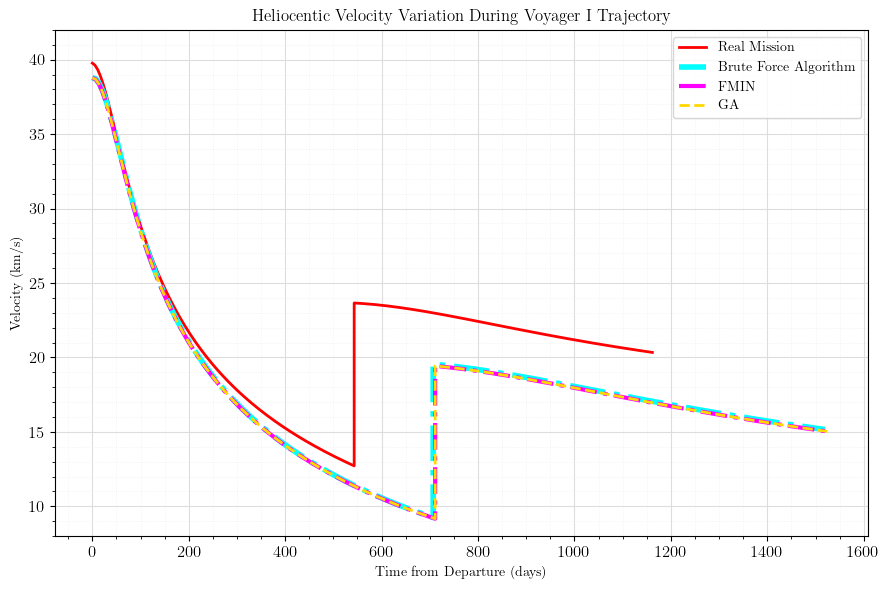

In [196]:
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

colours = {
    "Real Mission": "red",
    "Brute Force Algorithm": "cyan",
    "FMIN": "magenta",
    "GA": "gold"
}

fig, ax = plt.subplots(figsize=(9, 6))

def plot_voyager_trajectory(date_departure, date_flyby_jupiter, date_flyby_saturn, method):
    flag = True
    print("Method:", method)

    planet1="earth"
    planet2="jupiter"
    
    days1, positions1, velocities1, v1, v2, tof_to_jupiter = plot_transfer_velocity(
        date1= date_departure, 
        date2= date_flyby_jupiter,
        planet1="earth", 
        planet2="jupiter",
        current_tof = 0,
        show_plot = flag, 
        num_points=100
    )
    
    print(f"[{planet1} to {planet2}] Initial velocity: {np.linalg.norm(v1):.2f} km/s")
    print(f"[{planet1} to {planet2}] Final velocity: {np.linalg.norm(v2):.2f} km/s")

    planet1="jupiter"
    planet2="saturn"

    days2, positions2, velocities2, v1, v2, tof_to_saturn = plot_transfer_velocity(
        date1= date_flyby_jupiter, 
        date2= date_flyby_saturn,
        planet1="jupiter", 
        planet2="saturn",
        current_tof = tof_to_jupiter,
        show_plot = flag, 
        num_points=100
    )
    
    print(f"\n[{planet1} to {planet2}] Initial velocity: {np.linalg.norm(v1):.2f} km/s")
    print(f"[{planet1} to {planet2}] Final velocity: {np.linalg.norm(v2):.2f} km/s\n--------------------------------------------------------")
    
    days_final = days1.tolist() + days2.tolist()
    velocities_final = velocities1 + velocities2
    
    plt.plot(days_final, velocities_final, color = colours[method], label=method)
    
    # # Add markers for departure and arrival
    # if method == "Real Mission":
    #     plt.scatter([days1[0], days1[-1]], [velocities1[0], velocities1[-1]], color='red', s=50, zorder=5, marker='x')
    #     plt.annotate(f'Departure: {velocities1[0]:.2f} km/s', (days1[0], velocities1[0]), 
    #                 xytext=(10, 10), textcoords='offset points')
    #     plt.annotate(f'Arrival: {velocities1[-1]:.2f} km/s', (days1[-1], velocities1[-1]), 
    #                 xytext=(-40, 10), textcoords='offset points')
        
    #     plt.scatter([days2[0], days2[-1]], [velocities2[0], velocities2[-1]], color='red', s=50, zorder=5, marker='x')
    #     plt.annotate(f'Departure: {velocities2[0]:.2f} km/s', (days2[0], velocities2[0]), 
    #                 xytext=(10, 10), textcoords='offset points')
    #     plt.annotate(f'Arrival: {velocities2[-1]:.2f} km/s', (days2[-1], velocities2[-1]), 
    #                 xytext=(-40, 10), textcoords='offset points')


plot_voyager_trajectory(
    date_departure,
    date_flyby_jupiter,
    date_flyby_saturn,
    method="Real Mission"
)

plot_voyager_trajectory(
    date_departure_BRUTE_MIN,
    date_flyby_jupiter_BRUTE_MIN,
    date_flyby_saturn_BRUTE_MIN,
    method="Brute Force Algorithm"
)

plot_voyager_trajectory(
    date_departure_FMIN,
    date_flyby_jupiter_FMIN,
    date_flyby_saturn_FMIN,
    method="FMIN"
)

plot_voyager_trajectory(
    date_departure_GA,
    date_flyby_jupiter_GA,
    date_flyby_saturn_GA,
    method="GA"
)

# Define different line styles for each plot
line_styles = {
    "Real Mission": "-",
    "Brute Force Algorithm": "-.",
    "FMIN": "-.",
    "GA": "--",
}
# Define different line widths for clarity
line_widths = {
    "Real Mission": 2,
    "Brute Force Algorithm": 4,
    "FMIN": 3,
    "GA": 2,
}

# Apply line styles
for line in ax.get_lines():
    label = line.get_label()
    for key in line_styles:
        if key in label:
            line.set_linestyle(line_styles[key])
            line.set_linewidth(line_widths[key])


plt.title(f'Heliocentic Velocity Variation During Voyager I Trajectory')

plt.xlabel('Time from Departure (days)')
plt.ylabel('Velocity (km/s)')
plt.legend()

plt.ylim(8,42)
    
# Improve grid and ticks
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax.minorticks_on()

# Customize tick parameters
ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=10)
plt.tight_layout()

plt.tight_layout()

plt.savefig("voyager_I_velocity_comparison.png", dpi=500, bbox_inches="tight")
plt.show()

## DeltaV to Fuel Mass

In [198]:
def compute_fuel_mass(M0, Vex, deltaV):
    Mf = M0*( 1 - np.exp(-deltaV/Vex) )
    return Mf 

def mission_fuel_mass(deltaV_injection, deltaV_jupiter):
    M0_1 = M0
    Mf_1 = compute_fuel_mass(M0_1, Vex, deltaV_injection)
    #print(Mf_1)
    M0_2 = M0_1 - Mf_1
    #print(M0_2)
    Mf_2 = compute_fuel_mass(M0_2, Vex, deltaV_jupiter)

    Mf_total = Mf_1 + Mf_2

    return Mf_total

deltaV_injection_values = {
    "REAL": data_dict_REAL['deltaV_injection (km/s)'],
    "Brute Force": data_dict_BRUTE_MIN['deltaV_injection (km/s)'],
    "Fmin": data_dict_FMIN['deltaV_injection (km/s)'],
    "Genetic Algorithm": data_dict_GA['deltaV_injection (km/s)'],
}

deltaV_jupiter_values = {
    "REAL": data_dict_REAL['deltaV_jupiter (km/s)'],
    "Brute Force": data_dict_BRUTE_MIN['deltaV_jupiter (km/s)'],
    "Fmin": data_dict_FMIN['deltaV_jupiter (km/s)'],
    "Genetic Algorithm": data_dict_GA['deltaV_jupiter (km/s)'],
}

# Compute and print fuel masses for each method
fuel_masses = {}
for method in deltaV_injection_values:
    fuel_masses[method] = mission_fuel_mass(deltaV_injection_values[method], deltaV_jupiter_values[method])
    print(f"{method}: {fuel_masses[method]:.2f} kg of fuel used")

REAL: 1139.00 kg of fuel used
Brute Force: 1071.75 kg of fuel used
Fmin: 1069.96 kg of fuel used
Genetic Algorithm: 1069.96 kg of fuel used


In [199]:
# Given deltaVs
deltaVss = {
    "REAL": deltaV_REAL,
    "Brute Force": deltaV_BRUTE_MIN,
    "Fmin": deltaV_FMIN,
    "Genetic Algorithm": deltaV_GA
}

fuel_masses = {}
for method in deltaVss:
    fuel_masses[method] = compute_fuel_mass(M0, Vex, deltaVss[method])

# Print results
for method, fuel_mass in fuel_masses.items():
    print(f"{method}: {fuel_mass:.2f} kg of fuel used")

REAL: 1139.00 kg of fuel used
Brute Force: 1071.75 kg of fuel used
Fmin: 1069.96 kg of fuel used
Genetic Algorithm: 1069.96 kg of fuel used


In [200]:
deltaVss # in km/s

{'REAL': 10.31241583834745,
 'Brute Force': 9.411191461145675,
 'Fmin': 9.388030073904538,
 'Genetic Algorithm': 9.388030090942555}